In [1]:
import seaborn as sns
import collections as col
import pandas as pd
import statistics
import os
import sys
import numpy as np
import matplotlib.pyplot as plt
from typing import Union
from pathlib import Path
import gseapy as gp
import functions_sheet as myfunc
from gseapy import barplot, dotplot
import re
import upsetplot as usp
from collections import Counter
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 200)
from gseapy import Msigdb
from gseapy import GSEA

path_to_main_comparison_dir = "/nfs/data3/IHEC/TF_PRIO/comparisons/cells"
path_to_all_tfs_file = "/nfs/data3/IHEC/TF_PRIO/additional_files/all_tfs.txt"
path_to_figure_folder = "/nfs/data3/IHEC/TF_PRIO/created_plots/4_comparisons_active_suppressive_intersection"

- creating df with set of every top / condition-specific TF for active and suppressive marks </br>
- adding intersection & other columns but remove the later because they're not needed

In [2]:
tf_overlap_df_tpm = myfunc.create_overlap_df_with_tpm(path_to_main_comparison_dir, tpm_filter=1)
tf_overlap_df_tpm = myfunc.add_overlap_union_unique_shared_with_all_or_once(tf_overlap_df_tpm)
tf_overlap_df_tpm = tf_overlap_df_tpm.drop(columns=["union", "unique", "shared_at_least_once", "shared_with_all"])

- create list of active and suppressive generalistic TF, with the threshold of minimum appearences discussed with ML
- removing the corresponding TFs from the TF sets (suppressive resulted in no generalistic TFs with this threshold)

In [3]:
generic_TFs_active, generic_TFs_suppressive = myfunc.read_out_generic_TFs(tf_overlap_df_tpm, 9)
tf_overlap_df_tpm["active_marks"] = tf_overlap_df_tpm["active_marks"].apply(lambda x: {tf for tf in x if tf not in generic_TFs_active})
tf_overlap_df_tpm["intersection"] = tf_overlap_df_tpm["intersection"].apply(lambda x: {tf for tf in x if tf not in generic_TFs_active})

# ORA on TFs

creating gene sets from selected databases

In [12]:
msig = Msigdb()

# cancer related gene sets:
MSigDB_computational = msig.get_gmt(category='c4.all', dbver="2023.2.Hs")
MSigDB_oncogenic_Signatures = msig.get_gmt(category='c6.all', dbver="2023.2.Hs")
gseapy_nci_cancer_cell_line = gp.get_library(name='NCI-60_Cancer_Cell_Lines', organism='Human')
gseapy_cancer_cell_line_encyclopedia = gp.get_library(name='Cancer_Cell_Line_Encyclopedia', organism='Human')

cancer_gene_sets = [MSigDB_computational, MSigDB_oncogenic_Signatures, gseapy_nci_cancer_cell_line, gseapy_cancer_cell_line_encyclopedia]

# normal gene sets
MSigDB_regulatory_target = msig.get_gmt(category='c3.all', dbver="2023.2.Hs")
MSigDB_GO = msig.get_gmt(category='c5.go', dbver="2023.2.Hs")
MSigDB_immunologic_signature = msig.get_gmt(category='c7.immunesigdb', dbver="2023.2.Hs")
MSigDB_cell_type = msig.get_gmt(category='c8.all', dbver="2023.2.Hs")
MSigDB_hallmarks = msig.get_gmt(category='h.all', dbver="2023.2.Hs")
gseapy_cell_marker_augmented = gp.get_library(name='CellMarker_Augmented_2021', organism='Human')
kegg = gp.get_library(name='KEGG_2021_Human', organism='Human')

normal_gene_sets = [MSigDB_regulatory_target, MSigDB_immunologic_signature, MSigDB_cell_type, 
                    MSigDB_GO, MSigDB_hallmarks, gseapy_cell_marker_augmented, kegg]



creating dictionaries that are used to replace the default created collection names like "gs_ind_0",  "gs_ind_1" etc.to the names of the collections

In [13]:
normal_gene_sets_renaming = {
                            "gs_ind_0": "MSigDB_Regulatory_Targets_2023",
                            "gs_ind_1": "MSigDB_Immunologic_Signatures_2023",
                            "gs_ind_2": "MSigDB_Cell_Type_Signatures_2023",
                            "gs_ind_3": "MSigDB_Gene_Ontology_2023",
                            "gs_ind_4": "MSigDB_Hallmark_2023",
                            "gs_ind_5": "CellMarker_Augmented_2021",
                            "gs_ind_6": "KEGG_2021_Human"}
cancer_gene_sets_renaming = {
                            "gs_ind_0": "MSigDB_Computational_2023",
                            "gs_ind_1": "MSigDB_Oncogenic_Signatures_2023",
                            "gs_ind_2": "NCI-60_Cancer_Cell_Lines",
                            "gs_ind_3": "Cancer_Cell_Line_Encyclopedia"}

creating a list of all used TFs and adjust them (e.g. for heterodimers "::" and other non-HGNC conform infromation like "(AG00)" )

In [6]:
all_tfs = pd.read_csv(path_to_all_tfs_file, sep="\t").columns.values
all_tfs_adjusted = myfunc.adjust_tfprio_used_TF(all_tfs)
print(len(all_tfs))
print(len(all_tfs_adjusted))

819
714


## ORA on healthy celltype comparisons with normal gene set

In [12]:
healthy_cell_tf_df = tf_overlap_df_tpm.drop(["b-cells-healthy-b-cells-leukemia"])

In [ ]:
healthy_cells_tf_results_dictionary = {}
for index, row in healthy_cell_tf_df.iterrows():
    for tf_type in healthy_cell_tf_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    #organism='human', # organism argment is ignored because user input a background
                    background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            healthy_cells_tf_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

### inspection on some genes of the discussed plots in the thesis

In [14]:
healthy_cells_tf_results_dictionary.keys()

dict_keys(['macrophage-healthy-neutrophil-healthy_suppressive_marks', 'macrophage-healthy-neutrophil-healthy_active_marks', 'macrophage-healthy-neutrophil-healthy_intersection', 'macrophage-healthy-monocyte-healthy_suppressive_marks', 'macrophage-healthy-monocyte-healthy_intersection', 'b-cells-healthy-t-cell-healthy_active_marks', 'b-cells-healthy-t-cell-healthy_intersection', 'macrophage-healthy-t-cell-healthy_suppressive_marks', 'macrophage-healthy-t-cell-healthy_active_marks', 'macrophage-healthy-t-cell-healthy_intersection', 'b-cells-healthy-monocyte-healthy_suppressive_marks', 'b-cells-healthy-monocyte-healthy_active_marks', 'monocyte-healthy-neutrophil-healthy_suppressive_marks', 'monocyte-healthy-neutrophil-healthy_active_marks', 'monocyte-healthy-neutrophil-healthy_intersection', 't-cell-healthy-neutrophil-healthy_suppressive_marks', 't-cell-healthy-neutrophil-healthy_active_marks', 't-cell-healthy-neutrophil-healthy_intersection', 'b-cells-healthy-macrophage-healthy_suppressi

In [16]:
b_cells_t_cells_active = healthy_cells_tf_results_dictionary["b-cells-healthy-t-cell-healthy_active_marks"]

In [19]:
b_cells_t_cells_active[b_cells_t_cells_active["Gene_set"]=="gs_ind_6"].sort_values(by=["Adjusted P-value"])

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
8316,gs_ind_6,ErbB signaling pathway,4/5,0.000521,0.021868,26.790210,202.544157,STAT5B;JUN;MYC;STAT5A
8332,gs_ind_6,Human T-cell leukemia virus 1 infection,12/40,0.000379,0.021868,4.223650,33.275366,STAT5B;ELK4;TCF3;STAT5A;CREB1;NFATC2;SMAD4;ETS...
8347,gs_ind_6,MAPK signaling pathway,8/20,0.000458,0.021868,6.321481,48.600686,NR4A1;ELK4;JUND;NFATC3;MEF2C;JUN;MAX;MYC
8327,gs_ind_6,Hepatitis B,10/33,0.001135,0.028613,4.205457,28.516097,STAT5B;STAT5A;CREB1;STAT3;STAT2;NFATC2;SMAD4;N...
8342,gs_ind_6,JAK-STAT signaling pathway,5/9,0.001012,0.028613,11.017336,75.969073,STAT5B;STAT5A;STAT3;STAT2;MYC
8301,gs_ind_6,Chemokine signaling pathway,4/7,0.003087,0.064825,11.445554,66.161945,STAT5B;STAT2;FOXO3;STAT3
8386,gs_ind_6,Th1 and Th2 cell differentiation,6/17,0.005320,0.071615,5.111354,26.764843,STAT5B;STAT5A;RUNX3;NFATC2;NFATC3;JUN
8355,gs_ind_6,Necroptosis,4/8,0.005684,0.071615,8.888112,45.952847,STAT5B;STAT2;STAT5A;STAT3
8361,gs_ind_6,Oxytocin signaling pathway,4/8,0.005684,0.071615,8.888112,45.952847,NFATC3;MEF2C;JUN;NFATC2
8362,gs_ind_6,PD-L1 expression and PD-1 checkpoint pathway i...,5/12,0.004929,0.071615,6.579196,34.953255,STAT3;BATF;NFATC2;NFATC3;JUN


## b cells leukemia vs healthy

In [14]:
leukemia_tf_df = tf_overlap_df_tpm.loc[["b-cells-healthy-b-cells-leukemia"]]

### with cancer sets

In [15]:
leukemia_tf_results_dictionary = {}
for index, row in leukemia_tf_df.iterrows():
    for tf_type in leukemia_tf_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=cancer_gene_sets,
                    #organism='human', # organism argment is ignored because user input a background
                    background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(cancer_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=5,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_"+index+"_"+tf_type+"_cancer_sets"
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            healthy_cells_tf_results_dictionary[index+"_"+tf_type] = enr_bg.results
            leukemia_tf_results_dictionary[index+"_"+tf_type] = enr_bg.results
            
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

For b-cells-healthy-b-cells-leukemia_suppressive_marks
For b-cells-healthy-b-cells-leukemia_active_marks
For b-cells-healthy-b-cells-leukemia_intersection


### with normal gene sets

In [ ]:
leukemia_tf_results_dictionary = {}
for index, row in leukemia_tf_df.iterrows():
    for tf_type in leukemia_tf_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    #organism='human', # organism argment is ignored because user input a background
                    background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=5,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        title = "",
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            leukemia_tf_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

## inspection on what those genes are for suppressive marks

In [43]:
leukemia_tf_df["suppressive_markers"][0]

{'CEBPA',
 'FOXJ2',
 'HIC2',
 'MAX::MYC',
 'MNT',
 'NFATC2',
 'NFE2L2',
 'NFYB',
 'POU2F1',
 'RELB',
 'SPIB',
 'STAT2',
 'TAF1',
 'VDR',
 'VENTX',
 'ZBED2',
 'ZEB1',
 'ZKSCAN5',
 'ZNF384',
 'ZNF416',
 'ZNF554'}

In [44]:
leukemia_tf_df["active_markers"][0]

{'ARID5B',
 'ARNT',
 'ARNTL',
 'ATF1',
 'ATF2',
 'BHLHA15',
 'CBFB',
 'CEBPA',
 'CEBPD',
 'CREB1',
 'ESRRA',
 'FOSB',
 'FOSB::JUNB',
 'FOSL2',
 'FOSL2::JUN',
 'FOSL2::JUND',
 'FOXJ2',
 'FOXJ3',
 'FOXK2',
 'FOXM1',
 'FOXO3',
 'FOXP1',
 'GATA3',
 'HESX1',
 'HOXA5',
 'HOXB2',
 'HOXB4',
 'HOXB7',
 'HOXC4',
 'IRF2',
 'JUN',
 'JUN::JUNB',
 'KLF10',
 'KLF14',
 'KLF8',
 'MAFK',
 'MAX',
 'MBD2',
 'MECP2',
 'MEF2A',
 'MEF2C',
 'MGA',
 'MNT',
 'MXI1',
 'MYB',
 'NFATC2',
 'NFYA',
 'NFYB',
 'NFYC',
 'NR4A1',
 'NR4A2',
 'PBX2',
 'POU2F1',
 'POU3F1',
 'POU6F1',
 'PPARA',
 'PRDM1',
 'PRDM4',
 'RBPJ',
 'REL',
 'RELA',
 'RFX7',
 'RREB1',
 'RUNX3',
 'SATB1',
 'SMAD4',
 'SNAI3',
 'SP2',
 'SREBF1',
 'STAT3',
 'STAT4',
 'STAT5B',
 'STAT6',
 'TAF1',
 'TBX6',
 'TCF12',
 'TCF3',
 'TEAD2',
 'TRIM28',
 'VDR',
 'VENTX',
 'YY1',
 'ZBED2',
 'ZBTB12',
 'ZBTB6',
 'ZBTB7A',
 'ZFX',
 'ZKSCAN5',
 'ZNF121',
 'ZNF135',
 'ZNF18',
 'ZNF189',
 'ZNF317',
 'ZNF341',
 'ZNF384',
 'ZNF460',
 'ZNF563',
 'ZNF768',
 'ZNF770',
 'ZNF7

In [41]:
leukemia_suppressive_ora_results_df = leukemia_results_dictionary['b-cells-healthy-b-cells-leukemia_suppressive_markers']

In [46]:
leukemia_suppressive_ora_results_df[leukemia_suppressive_ora_results_df["Gene_set"]=="gs_ind_3"].sort_values(by="Adjusted P-value")[1:10]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
3262,gs_ind_3,GOBP_POSITIVE_REGULATION_OF_UBIQUITIN_DEPENDEN...,3/3,0.000025,0.005621,248.589744,2629.369796,NFE2L2;CEBPA;TAF1
3238,gs_ind_3,GOBP_POSITIVE_REGULATION_OF_PROTEASOMAL_UBIQUI...,3/3,0.000025,0.005621,248.589744,2629.369796,NFE2L2;CEBPA;TAF1
3237,gs_ind_3,GOBP_POSITIVE_REGULATION_OF_PROTEASOMAL_PROTEI...,3/3,0.000025,0.005621,248.589744,2629.369796,NFE2L2;CEBPA;TAF1
3242,gs_ind_3,GOBP_POSITIVE_REGULATION_OF_PROTEOLYSIS,4/9,0.000077,0.013666,30.405405,287.805703,MYC;NFE2L2;CEBPA;TAF1
3391,gs_ind_3,GOBP_REGULATION_OF_PROTEASOMAL_PROTEIN_CATABOL...,3/5,0.000245,0.023991,49.574359,412.213103,NFE2L2;TAF1;CEBPA
3435,gs_ind_3,GOBP_REGULATION_OF_UBIQUITIN_DEPENDENT_PROTEIN...,3/5,0.000245,0.023991,49.574359,412.213103,NFE2L2;TAF1;CEBPA
3392,gs_ind_3,GOBP_REGULATION_OF_PROTEASOMAL_UBIQUITIN_DEPEN...,3/5,0.000245,0.023991,49.574359,412.213103,NFE2L2;TAF1;CEBPA
3402,gs_ind_3,GOBP_REGULATION_OF_PROTEOLYSIS_INVOLVED_IN_PRO...,3/5,0.000245,0.023991,49.574359,412.213103,NFE2L2;TAF1;CEBPA
3578,gs_ind_3,GOCC_NUCLEAR_PROTEIN_CONTAINING_COMPLEX,11/125,0.000391,0.034478,5.052402,39.646393,MAX;STAT2;NFATC2;MYC;VDR;TAF1;NFE2L2;NFYB;RELB...


## comparison with the data from Berest et al.  (2019) to find the 2 main TFs they report: PAX5.A (repressor) and IRF2 (activator)

In [45]:
tpm_1_df = myfunc.get_tpm_filtered_genes_df(path_to_main_comparison_dir, tpm_filter=1)
tpm_1_df["length"] = tpm_1_df["TPM_filtered_genes"].apply(lambda x: len(x))
#tpm_df

In [53]:
print("PAX5.A" in tpm_1_df.at["b-cells-leukemia","TPM_filtered_genes"])
print("PAX5.A" in tpm_1_df.at["b-cells-healthy","TPM_filtered_genes"])
print("PAX5" in tpm_1_df.at["b-cells-leukemia","TPM_filtered_genes"])
print("PAX5" in tpm_1_df.at["b-cells-healthy","TPM_filtered_genes"])
print("PAX5.A" in tpm_0_df.at["b-cells-leukemia","TPM_filtered_genes"])
print("PAX5.A" in tpm_0_df.at["b-cells-healthy","TPM_filtered_genes"])
print("PAX5" in tpm_0_df.at["b-cells-leukemia","TPM_filtered_genes"])
print("PAX5" in tpm_0_df.at["b-cells-healthy","TPM_filtered_genes"])
print("IRF2" in tpm_1_df.at["b-cells-leukemia","TPM_filtered_genes"])
print("IRF2" in tpm_1_df.at["b-cells-healthy","TPM_filtered_genes"])
print("IRF2" in tpm_0_df.at["b-cells-leukemia","TPM_filtered_genes"])
print("IRF2" in tpm_0_df.at["b-cells-healthy","TPM_filtered_genes"])

False
False
False
False
False
False
False
False
True
True
True
True


In [50]:
tpm_0_df = myfunc.get_tpm_filtered_genes_df(path_to_main_comparison_dir, tpm_filter=1)
tpm_0_df["length"] = tpm_1_df["TPM_filtered_genes"].apply(lambda x: len(x))

# GSEA on active / supressive TFs

reading in the top TFs with their TF-Prio scores and removing the generalistic active TFs

In [19]:
tf_score_df = myfunc.create_overlap_df_with_tpm(path_to_main_comparison_dir, tpm_filter=1, modus="dataframe")
#tf_score_df = tf_score_df.rename(columns={"euchromatin": "active_marks", "heterochromatin": "suppressive_marks"})
tf_score_df["active_marks"] = tf_score_df["active_marks"].apply(lambda df: df[~df["TF"].isin(generic_TFs_active)])

## preranked GSEA on healthy cells

In [20]:
healthy_cell_tf_score_df = tf_score_df.drop(["b-cells-healthy-b-cells-leukemia"])

2024-07-14 20:32:52,171 [INFO] Parsing data files for GSEA.............................
2024-07-14 20:32:52,445 [INFO] 20685 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-07-14 20:32:52,447 [INFO] 0657 gene_sets used for further statistical testing.....
2024-07-14 20:32:52,448 [INFO] Start to run GSEA...Might take a while..................
2024-07-14 20:32:53,093 [INFO] Congratulations. GSEApy runs successfully................

2024-07-14 20:32:54,368 [INFO] Parsing data files for GSEA.............................
2024-07-14 20:32:54,628 [INFO] 21243 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-07-14 20:32:54,630 [INFO] 0099 gene_sets used for further statistical testing.....
2024-07-14 20:32:54,631 [INFO] Start to run GSEA...Might take a while..................
2024-07-14 20:32:54,732 [INFO] Congratulations. GSEApy runs successfully................

2024-07-14 20:32:56,308 [INFO] Parsing data files for GSEA..........................

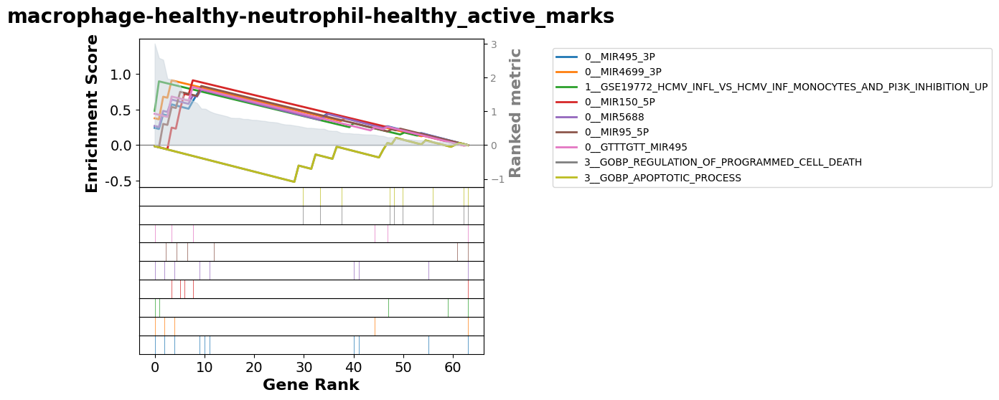

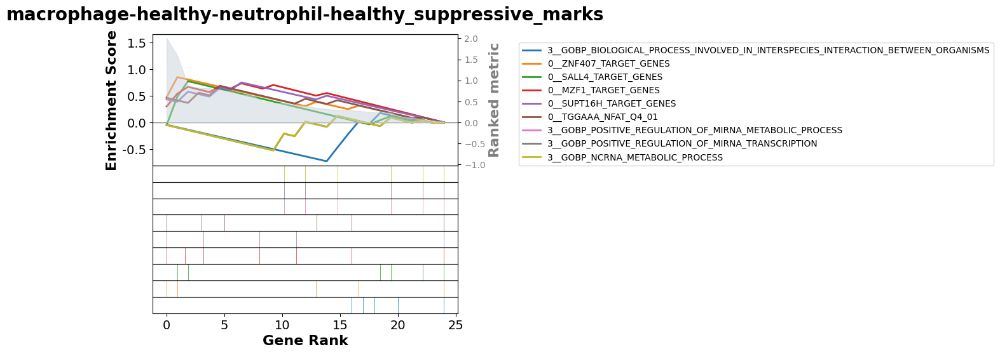

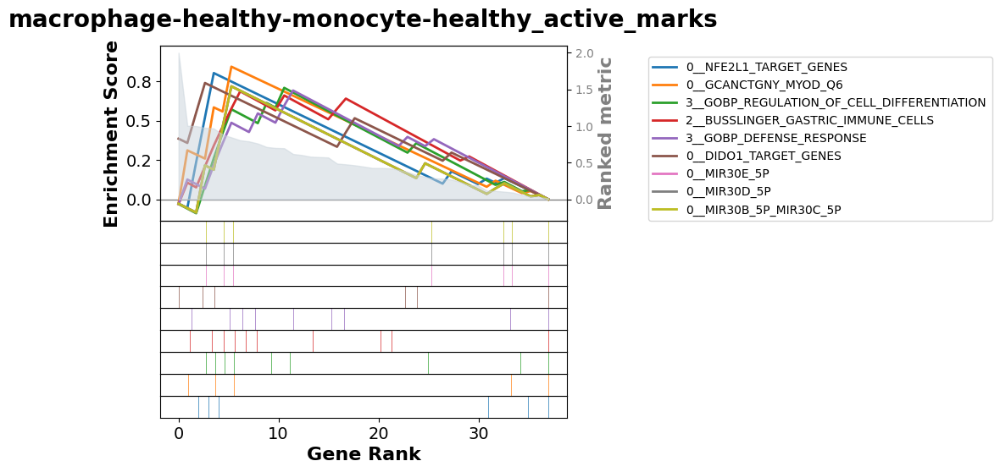

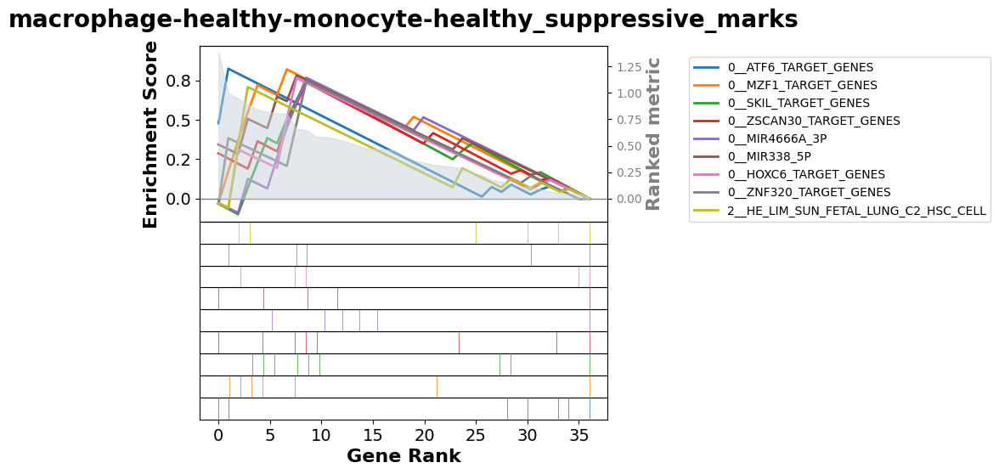

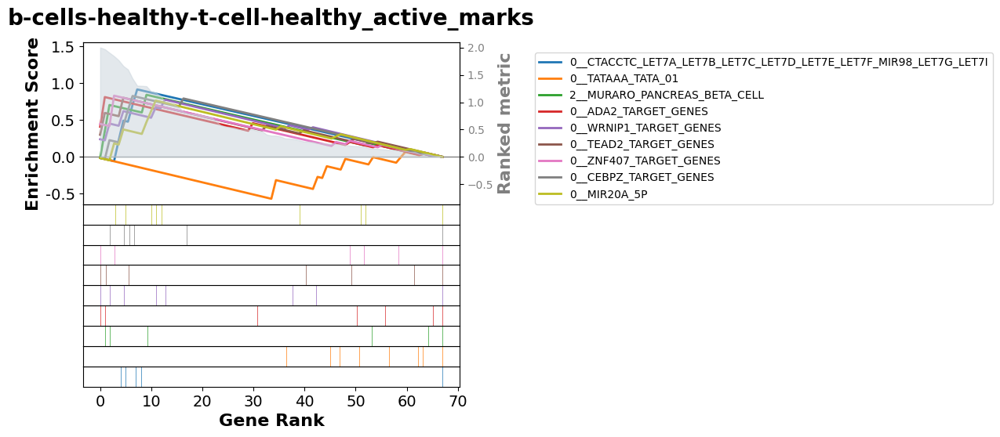

...

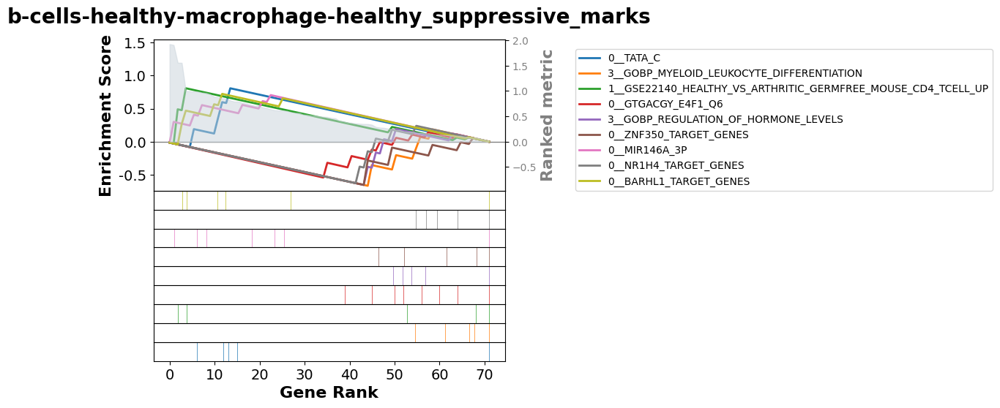

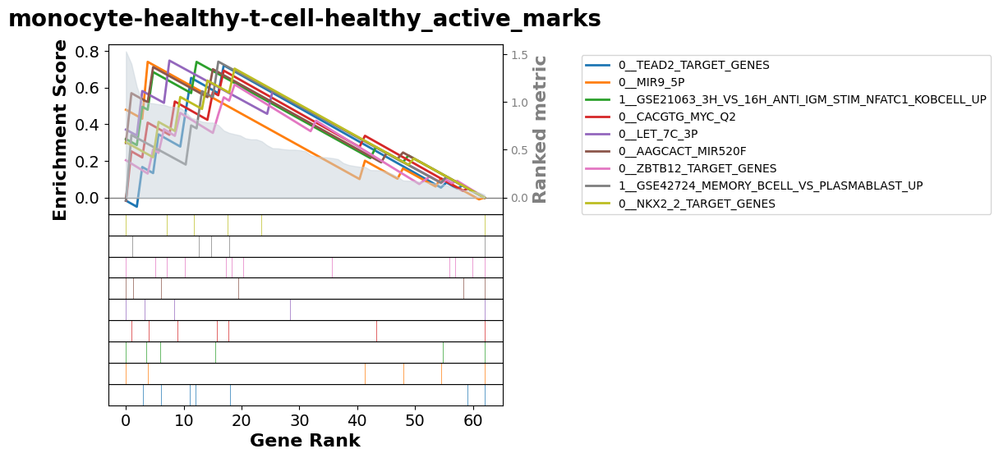

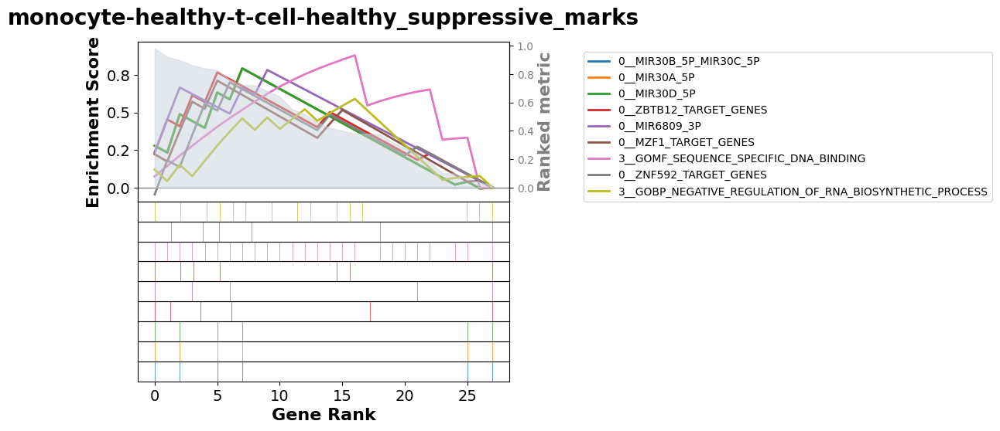

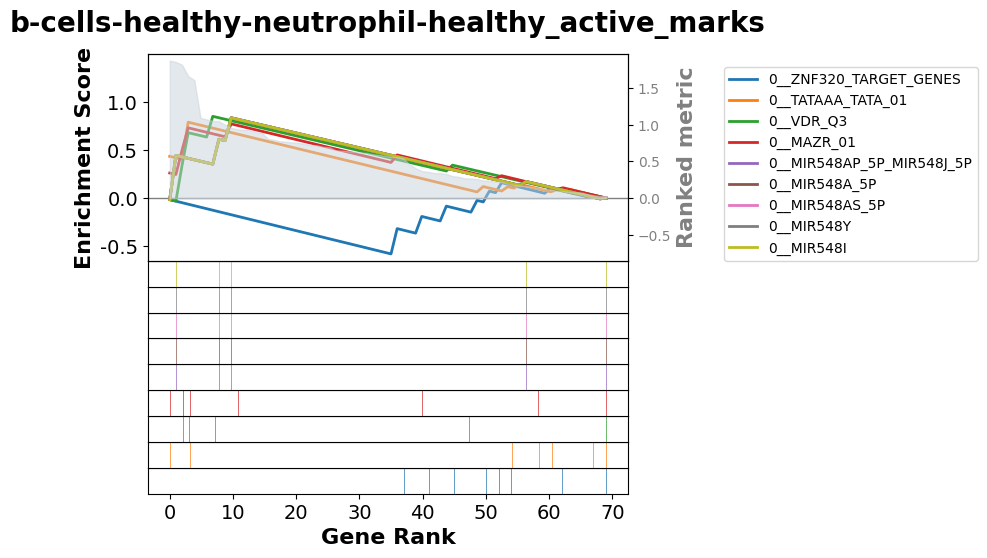

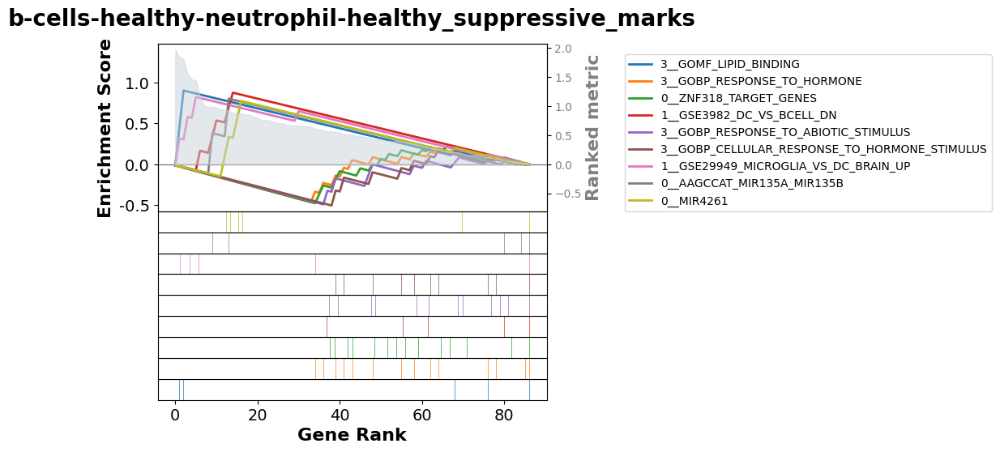

In [22]:
gsea_tf_results_dictionary = {}
for index, row in healthy_cell_tf_score_df.iterrows():
    for tf_type in ["active_marks", "suppressive_marks"]:
        scores_df = row[tf_type].rename(columns={'TF': '0', 'SCORE': '1'})
        pre_res = gp.prerank(rnk=scores_df, 
                     gene_sets=normal_gene_sets,
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=2000, # reduce number to speed up testing
                     outdir=None, # don't write to disk
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )
    
        try:
            terms = pre_res.res2d.Term
            axs = pre_res.plot(terms=terms[1:10],
                            legend_kws={'loc': (1.2, 0)}, # set the legend loc
                            show_ranking=True, # whether to show the second yaxis
                            figsize=(3,4)
                            )
            axs.suptitle(index+"_"+tf_type, fontsize=20, fontweight='bold')
            #ax.set_title(index+"_"+tf_type, loc="right", fontsize=20,fontweight='bold')
            figure_file_name = "GSEA_TF_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            gsea_tf_results_dictionary[index+"_"+tf_type] = pre_res
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

### closer analysis of enriched gene sets of interest

In [52]:
healthy_cell_tf_score_df

,suppressive_markers,active_markers
macrophage-healthy-monocyte-healthy,TF SCORE 5 ZNF770 1.3...,TF SCORE 0 NR2C1 2...
b-cells-healthy-t-cell-healthy,TF SCORE 2 NFE2L1 1...,TF SCORE 4 ZNF384 2.000...
macrophage-healthy-t-cell-healthy,TF SCORE 1 ARID5B 1.910...,TF SCORE 1 KLF5 2.4...
b-cells-healthy-monocyte-healthy,TF SCORE 3 KLF8 1.00000...,TF SCORE 0 NR2C1 3...
macrophage-healthy-neutrophil-healthy,TF SCORE 0 ZNF384 2...,TF SCORE 2 KLF5 2...
monocyte-healthy-neutrophil-healthy,TF SCORE 3 ZNF384 1...,TF SCORE 8 ZNF354C 1...
t-cell-healthy-neutrophil-healthy,TF SCORE 1 ARID5B 1.8...,TF SCORE 3 CBFB 2...
b-cells-healthy-macrophage-healthy,TF SCORE 0 ZNF354C 1...,TF SCORE 2 ZBTB26 1.00000...
monocyte-healthy-t-cell-healthy,TF SCORE 4 ARID5B 0.9...,TF SCORE 9 MEF2C ...
b-cells-healthy-neutrophil-healthy,TF SCORE 0 KLF8 1...,TF SCORE 2 HOXC4 1...


In [55]:
macrophage_monocyte_active = results_dictionary["macrophage-healthy-monocyte-healthy_active_markers"].res2d
macrophage_monocyte_active
b_cells_macrophage_suppressive = results_dictionary["b-cells-healthy-macrophage-healthy_suppressive_markers"].res2d

In [56]:
b_cells_macrophage_suppressive

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,0__SCGGAAGY_ELK1_02,0.929638,1.825566,0.0,0.251472,0.1535,3/5,6.25%,LYL1;ZNF394;ZNF384
1,prerank,0__TATA_C,0.808168,1.608855,0.010576,1.0,0.934,4/5,20.00%,HOXC4;NFATC2;PRDM1;EPAS1
2,prerank,3__GOBP_MYELOID_LEUKOCYTE_DIFFERENTIATION,-0.666667,-1.607307,0.028571,1.0,0.7695,5/5,38.75%,FOSL2;KLF10;BATF;CREB1;RELB
3,prerank,1__GSE22140_HEALTHY_VS_ARTHRITIC_GERMFREE_MOUS...,0.808682,1.579598,0.010071,1.0,0.968,2/5,6.25%,LYL1;ZNF384
4,prerank,0__GTGACGY_E4F1_Q6,-0.541667,-1.575821,0.04023,1.0,0.826,8/8,52.50%,JUND;RELA;NR4A1;CREB1;ATF1;RELB;NR4A2;FOSB
...,...,...,...,...,...,...,...,...,...,...
801,prerank,3__GOBP_NCRNA_TRANSCRIPTION,0.219231,0.469568,0.995528,1.0,1.0,5/7,67.50%,NFATC2;POU2F1;SREBF2;SREBF1;SMAD4
802,prerank,3__GOBP_CELLULAR_RESPONSE_TO_HORMONE_STIMULUS,0.208333,0.462785,0.99672,1.0,1.0,8/8,81.25%,NFE2L2;MEF2C;FOSB;NR4A2;SREBF1;MAX;NR4A1;RELA
803,prerank,1__GSE339_EX_VIVO_VS_IN_CULTURE_CD8POS_DC_DN,0.235309,0.46038,0.998802,0.99899,1.0,3/5,57.50%,STAT4;RORA;NR4A2
804,prerank,0__YCATTAA_UNKNOWN,0.205479,0.436255,1.0,0.999555,1.0,7/7,81.25%,PRDM1;RUNX3;TRPS1;ZBTB17;MNT;RREB1;RELA


## preranked GSEA on b-cell leukemia comparison

In [24]:
leukemia_tf_score_df = tf_score_df.loc[["b-cells-healthy-b-cells-leukemia"]]

### preranked GSEA with cancer gene sets

2024-07-14 21:00:16,374 [INFO] Parsing data files for GSEA.............................
2024-07-14 21:00:16,407 [INFO] 2216 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-07-14 21:00:16,408 [INFO] 0039 gene_sets used for further statistical testing.....
2024-07-14 21:00:16,409 [INFO] Start to run GSEA...Might take a while..................
2024-07-14 21:00:16,468 [INFO] Congratulations. GSEApy runs successfully................

2024-07-14 21:00:17,682 [INFO] Parsing data files for GSEA.............................
2024-07-14 21:00:17,726 [INFO] 2255 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-07-14 21:00:17,727 [ERROR] No gene sets passed through filtering condition !!! 
Hint 1: Try to lower min_size or increase max_size !
Hint 2: Check gene symbols are identifiable to your gmt input.
Hint 3: Gene symbols curated in Enrichr web services are all upcases.

2024-07-14 21:00:17,728 [ERROR] The first entry of your gene_sets (gmt) look lik

For b-cells-healthy-b-cells-leukemia_suppressive_marks
No gene sets passed through filtering condition !!! 
Hint 1: Try to lower min_size or increase max_size !
Hint 2: Check gene symbols are identifiable to your gmt input.
Hint 3: Gene symbols curated in Enrichr web services are all upcases.



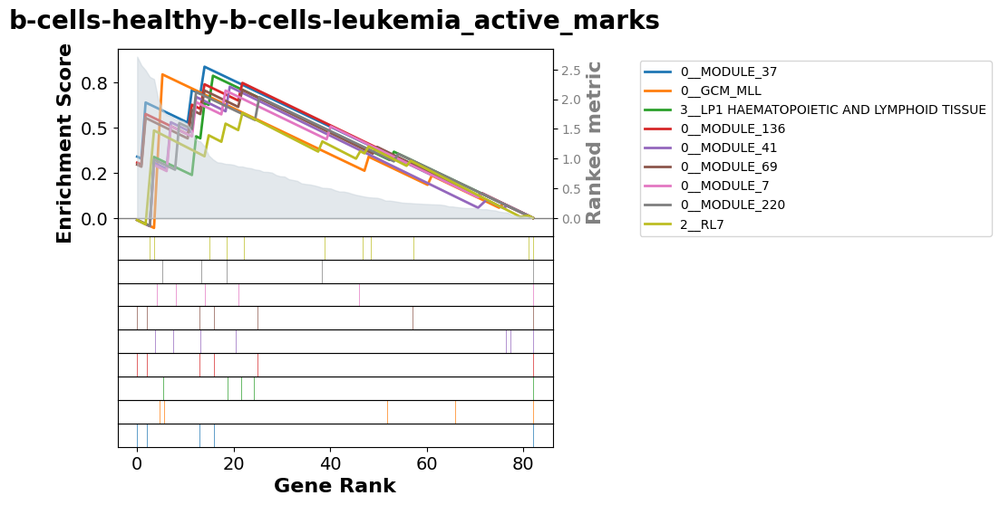

In [25]:
gsea_leukemia_tf_results_dictionary = {}
for index, row in leukemia_tf_score_df.iterrows():
    for tf_type in ["active_marks", "suppressive_marks"]:
        scores_df = row[tf_type].rename(columns={'TF': '0', 'SCORE': '1'})
        try:
            pre_res = gp.prerank(rnk=scores_df, 
                        gene_sets=cancer_gene_sets,
                        threads=4,
                        min_size=5,
                        max_size=1000,
                        permutation_num=2000, # reduce number to speed up testing
                        outdir=None, # don't write to disk
                        seed=6,
                        verbose=True, # see what's going on behind the scenes
                        )
            terms = pre_res.res2d.Term
            axs = pre_res.plot(terms=terms[1:10],
                            legend_kws={'loc': (1.2, 0)}, # set the legend loc
                            show_ranking=True, # whether to show the second yaxis
                            figsize=(3,4)
                            )
            axs.suptitle(index+"_"+tf_type, fontsize=20, fontweight='bold')
            gsea_leukemia_tf_results_dictionary[index+"_"+tf_type] = pre_res
            figure_file_name = "GSEA_TF_"+index+"_"+tf_type + "_cancer_sets"
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
        except LookupError as le:
            print("For "+str(index)+"_"+tf_type)
            print(le)

#### Analysis of the resulting gene sets for leukemia active  markers

In [39]:
gsea_leukemia_tf_results_dictionary["b-cells-healthy-b-cells-leukemia_active_marks"].res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,1__CYCLIN_D1_UP.V1_DN,-0.677778,-1.566273,0.037162,0.1305,0.138438,5/5,36.84%,PPARA;ATF2;PBX2;POU3F1;ARNT
1,prerank,0__MODULE_37,0.837342,1.519652,0.01194,0.462766,0.3285,4/5,17.89%,HOXC4;GATA3;STAT3;PRDM1
2,prerank,0__GCM_MLL,0.794736,1.447791,0.029046,0.540665,0.593,2/5,7.37%,ZNF384;PRDM4
3,prerank,3__LP1 HAEMATOPOIETIC AND LYMPHOID TISSUE,0.787345,1.426487,0.042992,0.458138,0.678,4/5,20.00%,MEF2C;POU6F1;PRDM1;KLF8
4,prerank,0__MODULE_136,0.747607,1.417284,0.050963,0.37844,0.713,5/6,27.37%,HOXC4;GATA3;STAT3;PRDM1;RFX7
5,prerank,0__MODULE_41,0.726733,1.410829,0.038053,0.322291,0.7375,4/7,24.21%,MEF2C;STAT4;POU6F1;VENTX
6,prerank,0__MODULE_69,0.708714,1.381653,0.061735,0.349731,0.831,5/7,27.37%,HOXC4;GATA3;STAT3;PRDM1;RFX7
7,prerank,0__MODULE_7,0.705102,1.333767,0.091633,0.44521,0.9225,4/6,23.16%,MEF2C;STAT4;POU6F1;REL
8,prerank,0__MODULE_220,0.697874,1.269902,0.14328,0.616443,0.981,3/5,15.79%,MEF2C;HOXB2;POU6F1
9,prerank,2__RL7,0.581756,1.21919,0.182812,0.752423,0.9955,5/11,27.37%,MEF2A;MEF2C;STAT6;REL;RFX7


In [49]:
test_df = results_dictionary["b-cells-healthy-b-cells-leukemia_active_markers"].res2d

In [50]:
test_df[test_df["FDR q-val"]<0.2]

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,1__CYCLIN_D1_UP.V1_DN,-0.677778,-1.566273,0.037162,0.1305,0.138438,5/5,36.84%,PPARA;ATF2;PBX2;POU3F1;ARNT


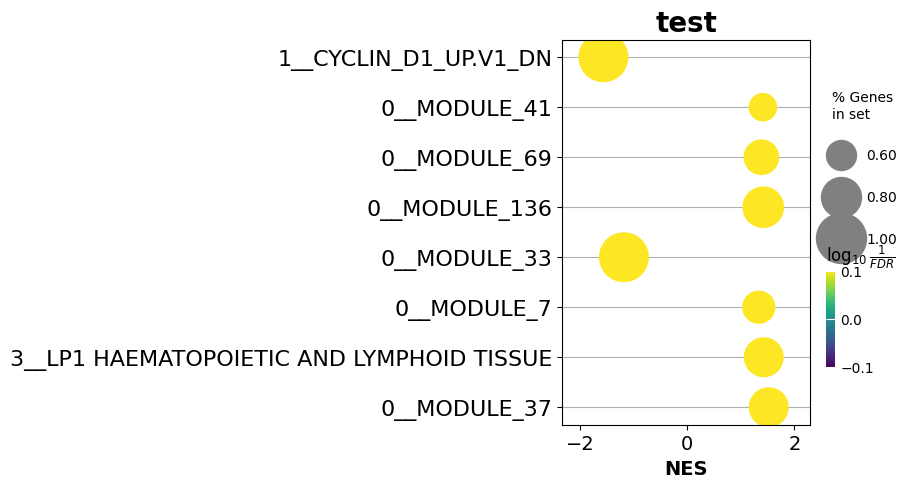

In [39]:
ax = dotplot(results_dictionary["b-cells-healthy-b-cells-leukemia_active_markers"].res2d,
             column="FDR q-val",
             title='test',
             cmap=plt.cm.viridis,
             size=6, # adjust dot size
             figsize=(4,5), cutoff=0.5, show_ring=False)

### preranked GSEA with normal gene sets
TODO: analyse some results

2024-07-14 21:00:53,339 [INFO] Parsing data files for GSEA.............................


2024-07-14 21:00:53,667 [INFO] 20222 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-07-14 21:00:53,669 [INFO] 1120 gene_sets used for further statistical testing.....
2024-07-14 21:00:53,670 [INFO] Start to run GSEA...Might take a while..................
2024-07-14 21:00:54,816 [INFO] Congratulations. GSEApy runs successfully................

2024-07-14 21:00:56,083 [INFO] Parsing data files for GSEA.............................
2024-07-14 21:00:56,355 [INFO] 21306 gene_sets have been filtered out when max_size=1000 and min_size=5
2024-07-14 21:00:56,357 [INFO] 0036 gene_sets used for further statistical testing.....
2024-07-14 21:00:56,358 [INFO] Start to run GSEA...Might take a while..................
2024-07-14 21:00:56,401 [INFO] Congratulations. GSEApy runs successfully................



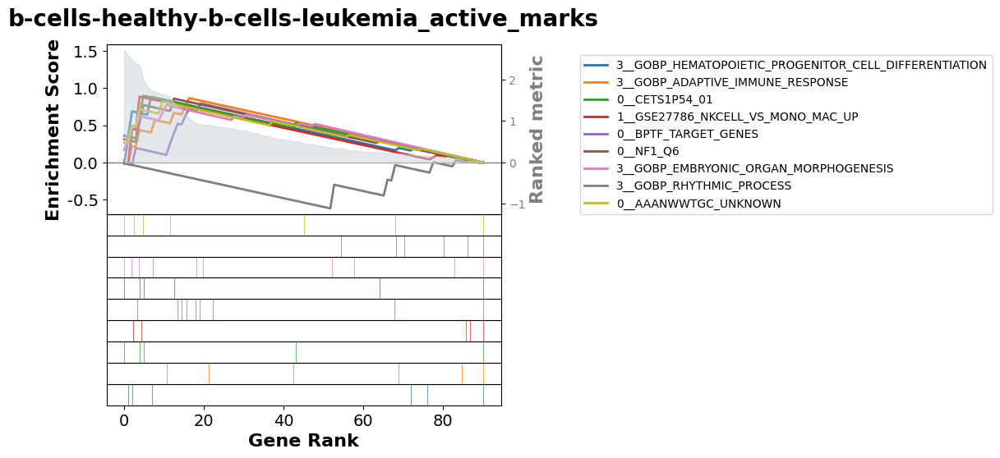

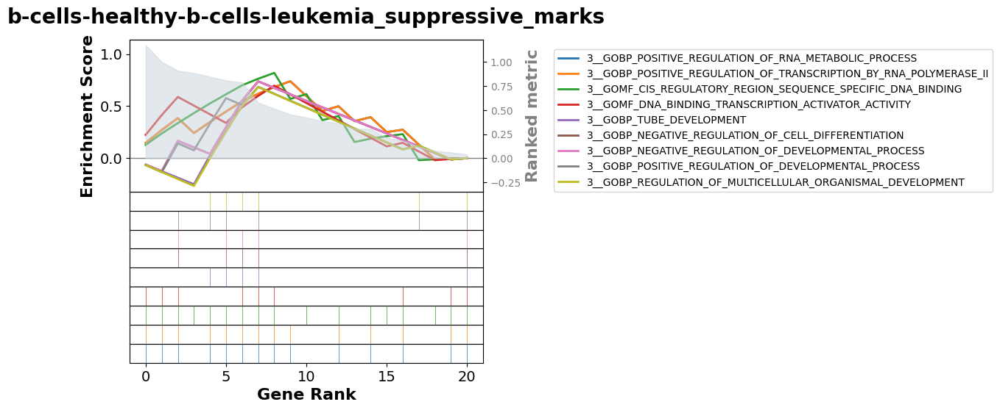

In [26]:
gsea_leukemia_tf_normal_sets_results_dictionary = {}
for index, row in leukemia_tf_score_df.iterrows():
    for tf_type in ["active_marks", "suppressive_marks"]:
        scores_df = row[tf_type].rename(columns={'TF': '0', 'SCORE': '1'})
        try:
            pre_res = gp.prerank(rnk=scores_df, 
                        gene_sets=normal_gene_sets,
                        threads=4,
                        min_size=5,
                        max_size=1000,
                        permutation_num=2000, # reduce number to speed up testing
                        outdir=None, # don't write to disk
                        seed=6,
                        verbose=True, # see what's going on behind the scenes
                        )
    
       
            terms = pre_res.res2d.Term
            axs = pre_res.plot(terms=terms[1:10],
                            legend_kws={'loc': (1.2, 0)}, # set the legend loc
                            show_ranking=True, # whether to show the second yaxis
                            figsize=(3,4)
                            )
            axs.suptitle(index+"_"+tf_type, fontsize=20, fontweight='bold')
            gsea_leukemia_tf_normal_sets_results_dictionary[index+"_"+tf_type] = pre_res
            figure_file_name = "GSEA_TF_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            gsea_leukemia_tf_normal_sets_results_dictionary[index+"_"+tf_type] = pre_res
        except LookupError as le:
            print("For "+str(index)+"_"+tf_type)
            print(le)

# ORA on TGs

reading in the gtf dictionary, based on the gtf file, that is used for the conversion of ensg symbols to hgnc symbols

In [4]:
gtf_dict = myfunc.read_gtf_and_create_ensg_hgnc_dict()

creating dataframes with either top K TGs for every TF or all TGs for every TF (above the affinity threshold)

In [5]:
df_top_k_tg = myfunc.read_out_filtered_target_genes_df(tf_overlap_df_tpm, path_to_main_comparison_dir)
df_all_tgs = myfunc.read_out_filtered_target_genes_df(tf_overlap_df_tpm, path_to_main_comparison_dir, modus = "all_genes")


converting the ENSG gene sets to HGNC gene sets

In [7]:
df_top_k_tg_hgnc = df_top_k_tg.applymap(lambda x: myfunc.convert_ensg_to_hgnc(x, gtf_dict))
df_all_tgs_hgnc = df_all_tgs.applymap(lambda x: myfunc.convert_ensg_to_hgnc(x, gtf_dict))

showing the resulting numbers of the dataframes

In [30]:
df_all_tgs_hgnc.applymap(lambda x: len(set(x)))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,9768,282,263
macrophage-healthy-monocyte-healthy,11721,890,1022
b-cells-healthy-t-cell-healthy,71,28041,73
macrophage-healthy-t-cell-healthy,315,26096,38
b-cells-healthy-monocyte-healthy,108,1329,295
monocyte-healthy-neutrophil-healthy,11816,1827,73
t-cell-healthy-neutrophil-healthy,19516,27274,38379
b-cells-healthy-macrophage-healthy,17193,34,69
b-cells-healthy-b-cells-leukemia,17834,21118,32990
monocyte-healthy-t-cell-healthy,101,28233,80


In [46]:
df_top_k_tg_hgnc.applymap(lambda x: len(set(x)))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,194,233,214
macrophage-healthy-monocyte-healthy,201,162,237
b-cells-healthy-t-cell-healthy,71,472,73
macrophage-healthy-t-cell-healthy,116,366,38
b-cells-healthy-monocyte-healthy,108,327,215
monocyte-healthy-neutrophil-healthy,145,489,73
t-cell-healthy-neutrophil-healthy,259,574,712
b-cells-healthy-macrophage-healthy,241,34,69
b-cells-healthy-b-cells-leukemia,169,499,464
monocyte-healthy-t-cell-healthy,97,576,80


## some testing reagrding a specific gene

In [12]:
monocyte_df = tf_overlap_df_tpm_changed.head(1).drop(columns=["unique","union", "shared_at_least_once", "shared_with_all"])
#tf_overlap_df_tpm_limited = tf_overlap_df_tpm_changed.drop(columns=["union", "shared_at_least_once", "shared_with_all"])
monocyte_df

,suppressive_markers,active_markers,intersection
macrophage-healthy-monocyte-healthy,"{ARNTL, STAT6, JUND, MYC, ZNF770, SP2, NFYA, M...","{HES6, TBP, ZNF784, ZNF770, MAFG, STAT2, MGA, ...","{PRDM4, CBFB, RELB, IRF2, ZNF770, VEZF1, NR2C1..."


In [13]:
df_cell_type_tfs_all_tgsMonocyte = pd.DataFrame.from_dict(myfunc.read_out_filtered_target_genes_dict(monocyte_df, path_to_main_comparison_dir, modus = "all_genes"), orient="index")


In [14]:
df_cell_type_tfs_all_tgsMonocyte

,suppressive_markers,active_markers,intersection
macrophage-healthy-monocyte-healthy,"[ENSG00000229820, ENSG00000119333, ENSG0000014...","[ENSG00000229820, ENSG00000119333, ENSG0000014...","[ENSG00000229820, ENSG00000119333, ENSG0000014..."


In [16]:
df_cell_type_tfs_all_tgsMonocyte_hgnc = df_cell_type_tfs_all_tgsMonocyte.applymap(lambda x: myfunc.convert_ensg_to_hgnc(x, gtf_dict))

In [17]:
df_cell_type_tfs_all_tgsMonocyte_hgnc["suppressive_markers"]

,suppressive_markers,active_markers,intersection
macrophage-healthy-monocyte-healthy,"{FLJ31104, AC012651.1, LINC00974, AC017079.2, ...","{BTBD10P2, CYP2D7, RF02124, RPL7AP2, FOXM1, RN...","{BTBD10P2, CYP2D7, RF02124, RPL7AP2, FOXM1, RN..."


In [20]:
"CSF1R" in df_cell_type_tfs_all_tgsMonocyte_hgnc["suppressive_markers"][0]

False

In [21]:
"CSF1R" in df_cell_type_tfs_all_tgsMonocyte_hgnc["active_markers"][0]

False

## healthy cell types

### top K TGs

In [31]:
df_healthy_cell_type_top_k_tg = df_top_k_tg_hgnc.drop(["b-cells-healthy-b-cells-leukemia"])

In [ ]:
top_k_tg_results_dictionary = {}
for index, row in df_healthy_cell_type_top_k_tg.iterrows():
    for tf_type in df_healthy_cell_type_top_k_tg.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', 
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("top_K_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_top_K_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            top_k_tg_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

### all TGs

In [33]:
df_healthy_cell_type_all_tg_hgnc = df_all_tgs_hgnc.drop(["b-cells-healthy-b-cells-leukemia"])

In [30]:
df_healthy_cell_type_all_tg_hgnc

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,"{FAIM2, RPL23AP53, AC013391.1, EIF4A1P9, AC036...","{SHPK, AL604028.2, MIR3611, SLFNL1, PPP1R35, B...","{SHPK, ZNF709, DUXA, AL604028.2, MIR3611, SLFN..."
macrophage-healthy-monocyte-healthy,"{TMEM170A, AC010485.1, AC008591.1, RPL23AP53, ...","{AC116914.1, ARHGEF18, PCBP2-OT1, AC093899.1, ...","{AC116914.1, ARHGEF18, PCBP2-OT1, AC093899.1, ..."
b-cells-healthy-t-cell-healthy,"{AC104989.1, AL359399.1, ISM1, RNA5SP242, AL16...","{CCDC58P5, AL392046.1, ZSWIM7, AC036108.1, AL0...","{AC103739.3, AC024619.3, RF00019, ISM1, ELF2, ..."
macrophage-healthy-t-cell-healthy,"{HOMER3-AS1, AC091152.3, LINC02130, C17orf113,...","{CCDC58P5, AL392046.1, ZSWIM7, AC036108.1, AL0...","{HOXC8, VAT1, AC079150.2, AC024619.3, HOXC4, A..."
b-cells-healthy-monocyte-healthy,"{AC091152.3, ZNF157, AC006262.4, MEF2C-AS2, ND...","{AC118344.2, VPS33A, ZSWIM7, SNORA73A, ZBED4, ...","{AC020908.3, ARHGEF18, AC091152.3, ZNF157, AC0..."
monocyte-healthy-neutrophil-healthy,"{FAIM2, TMEM170A, AC010485.1, AC008591.1, RPL2...","{AC116914.1, CLEC17A, AC118344.2, PPP1R35, VPS...","{IWS1, RN7SL150P, CACTIN-AS1, PTGS1, RF00019, ..."
t-cell-healthy-neutrophil-healthy,"{AL392046.1, FAIM2, CMC4, TMEM170A, AC074257.1...","{CCDC58P5, AL392046.1, ZSWIM7, AC036108.1, AL0...","{CCDC58P5, AL392046.1, AC010485.1, AC008591.1,..."
b-cells-healthy-macrophage-healthy,"{FAIM2, ASF1A, RPS3AP5, AC074257.1, RPL23AP53,...","{AC092620.2, VAT1, MIR3611, THOC6, AC006146.1,...","{AC092620.2, CBX1P5, AC003684.1, MIR3611, EEF1..."
monocyte-healthy-t-cell-healthy,"{FCAR, ZNF157, MAJIN, AP000797.3, RNA5SP367, N...","{CCDC58P5, AL392046.1, ZSWIM7, AC036108.1, AL0...","{AP000797.3, NDUFB4P12, KRT8P7, AFG3L1P, TUBBP..."
b-cells-healthy-neutrophil-healthy,"{FAIM2, ASF1A, RPS3AP5, AC074257.1, KNG1, AC01...","{AL512604.1, SOD1P1, MAML1, RNU6-1310P, GAMT, ...","{LINC02171, AL512604.1, SOD1P1, MAML1, NFATC4,..."


For monocyte-healthy-t-cell-healthy_intersection
For b-cells-healthy-neutrophil-healthy_intersection


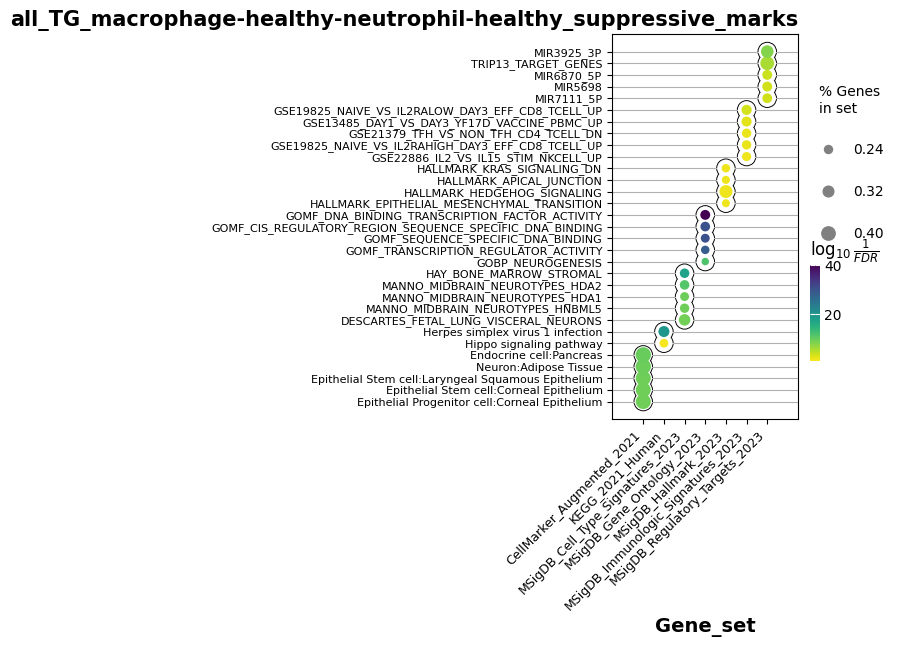

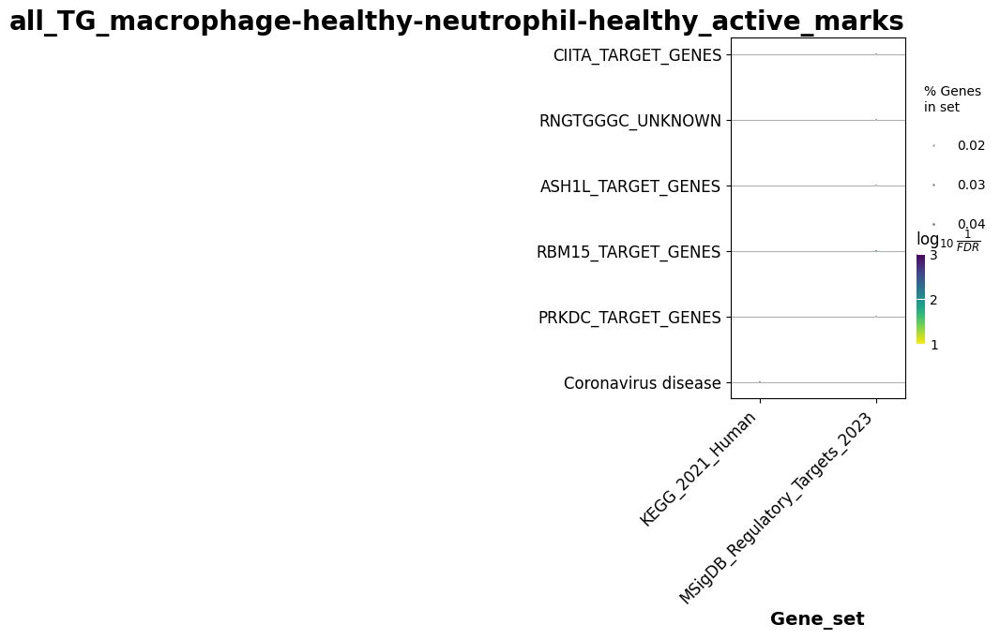

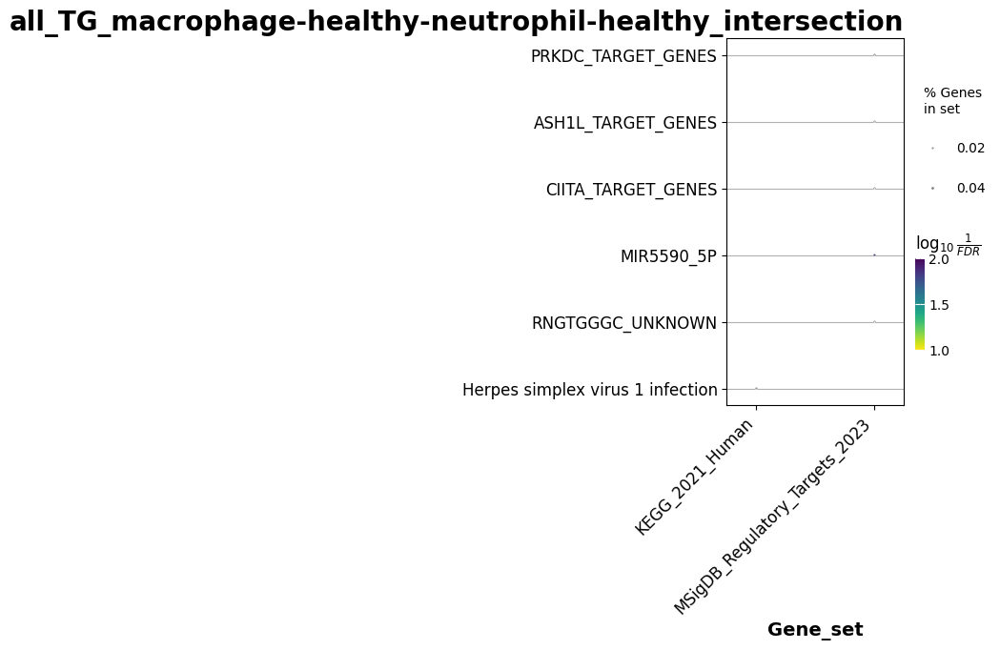

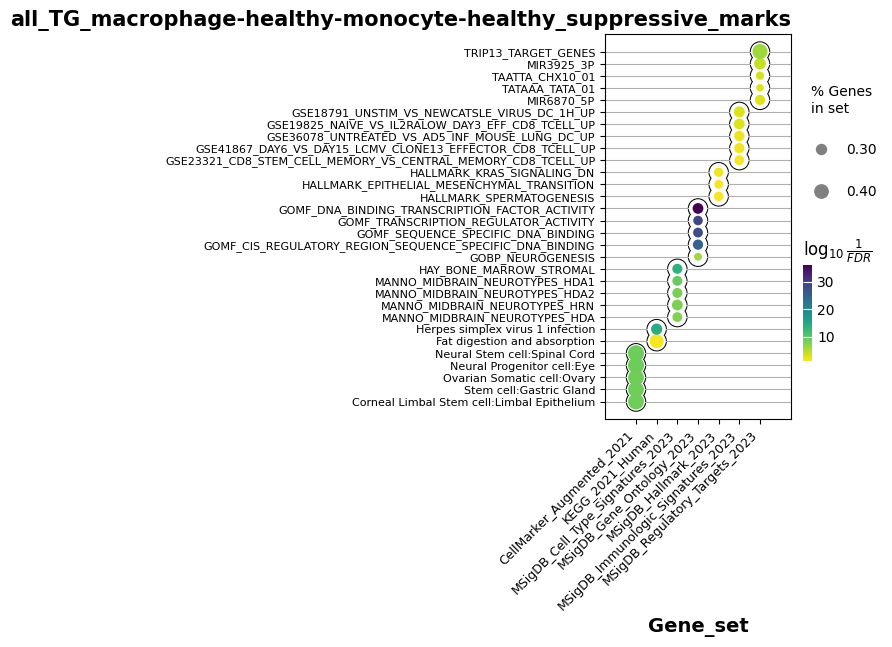

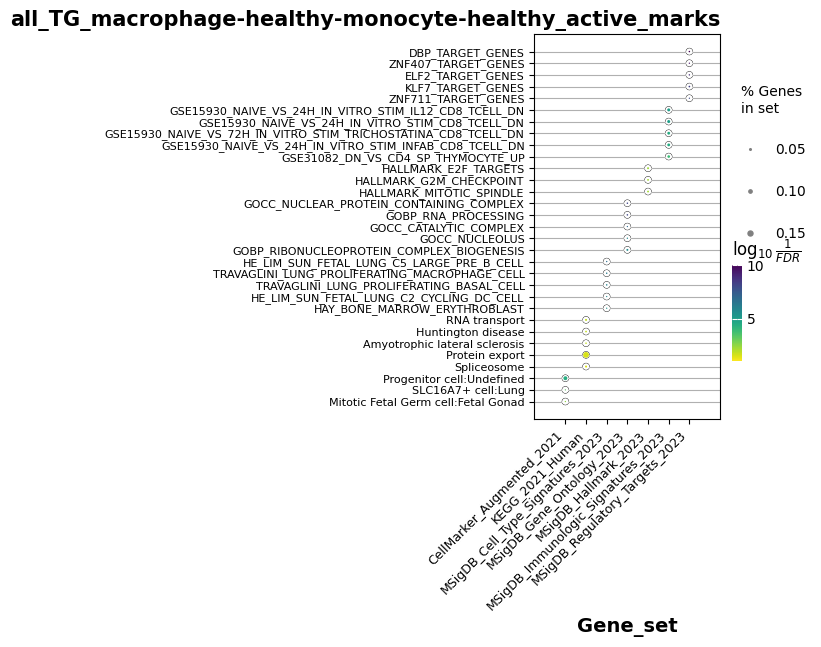

...

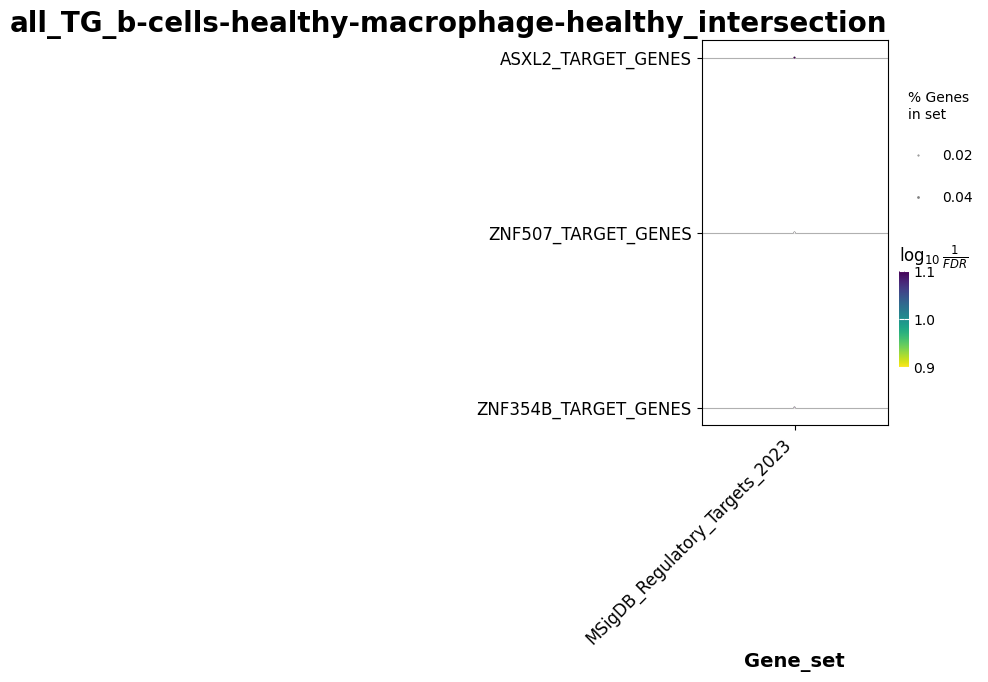

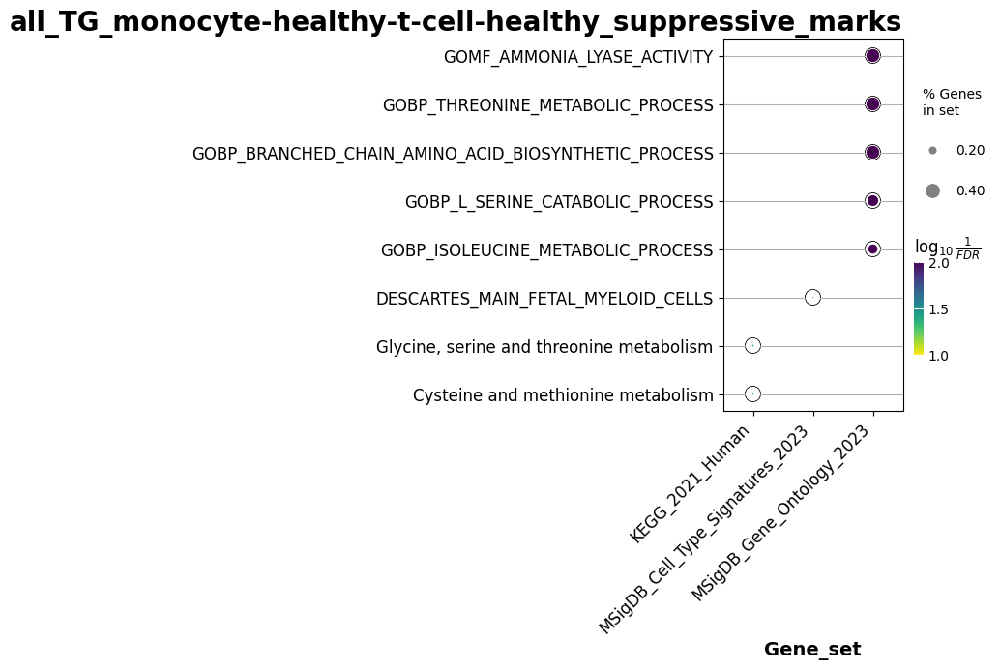

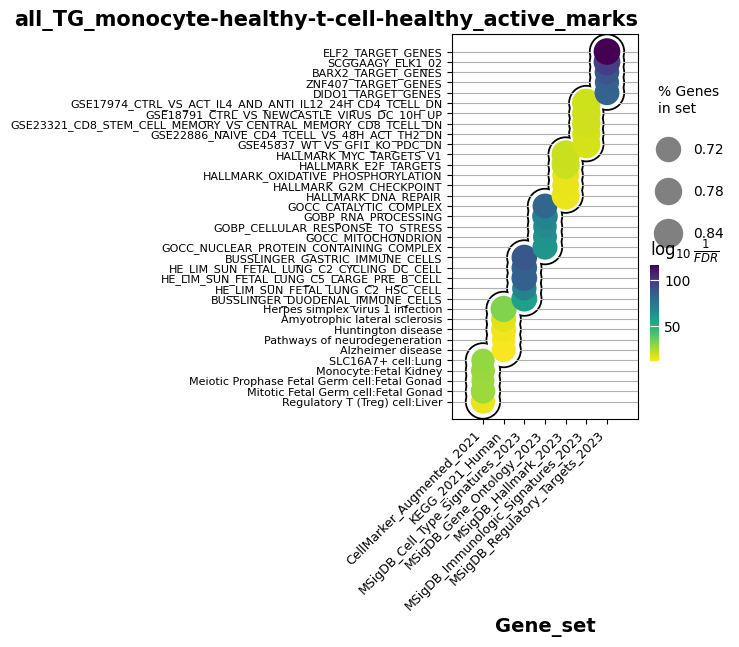

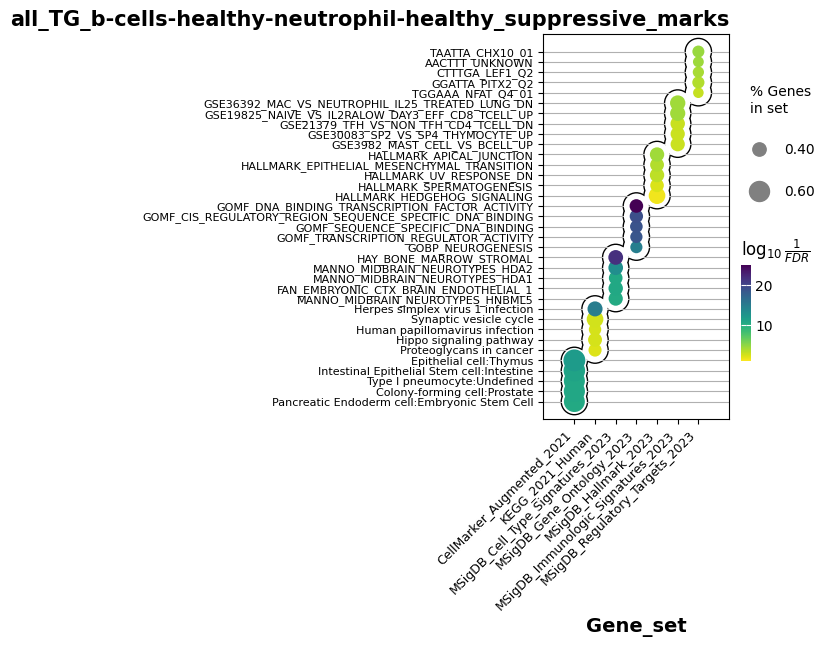

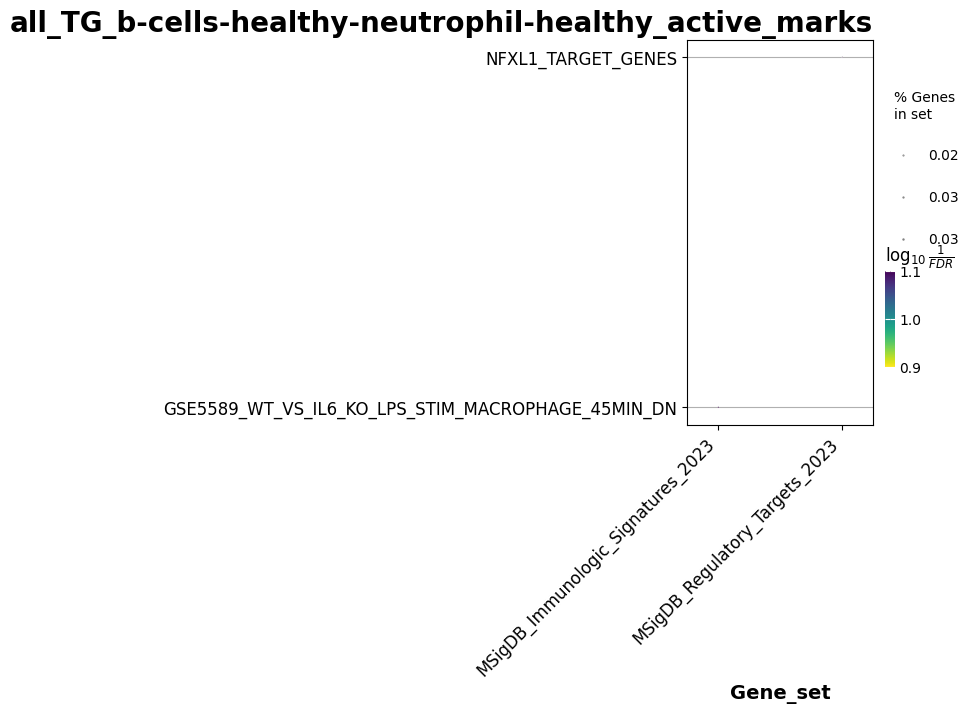

In [53]:
all_tg_results_dictionary = {}

for index, row in df_healthy_cell_type_all_tg_hgnc.iterrows():
    for tf_type in df_healthy_cell_type_all_tg_hgnc.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("all_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_all_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            all_tg_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

### Analysis of TF master regualtors

In [27]:
df_cell_type_all_tg_hgnc.applymap(lambda x: len(x))


,suppressive_markers,active_markers,intersection
macrophage-healthy-neutrophil-healthy,9768,282,263
macrophage-healthy-monocyte-healthy,11721,890,1022
b-cells-healthy-t-cell-healthy,71,28041,73
macrophage-healthy-t-cell-healthy,315,26096,38
b-cells-healthy-monocyte-healthy,108,1329,295
monocyte-healthy-neutrophil-healthy,11816,1827,73
t-cell-healthy-neutrophil-healthy,19516,27274,38379
b-cells-healthy-macrophage-healthy,17193,34,69
monocyte-healthy-t-cell-healthy,101,28233,80
b-cells-healthy-neutrophil-healthy,17041,142,154


In [29]:
healthy_cell_tf_df.applymap(lambda x: len(x))


,suppressive_markers,active_markers,intersection
macrophage-healthy-neutrophil-healthy,27,80,20
macrophage-healthy-monocyte-healthy,39,46,10
b-cells-healthy-t-cell-healthy,45,80,20
macrophage-healthy-t-cell-healthy,79,61,28
b-cells-healthy-monocyte-healthy,38,83,18
monocyte-healthy-neutrophil-healthy,37,88,20
t-cell-healthy-neutrophil-healthy,33,67,15
b-cells-healthy-macrophage-healthy,80,46,23
monocyte-healthy-t-cell-healthy,28,71,16
b-cells-healthy-neutrophil-healthy,87,76,37


In [32]:
tf_master_regulators_df = read_out_master_regulator_tf(df_cell_type_tfs_all_tg_hgnc, healthy_cell_tf_df, path_to_main_comparison_dir, min_num_tg_total=9000, min_num_tgs_per_tf=500)

120


In [20]:
all_tf_master_regulators_df, all_tf_master_regulators_dict = read_out_master_regulator_tf(df_all_tgs_hgnc, tf_overlap_df_tpm_changed, path_to_main_comparison_dir, min_num_tg_total=9000, min_num_tgs_per_tf=500)

132


In [15]:
all_tf_master_regulators_df["target_strings_hgnc"] = all_tf_master_regulators_df.apply(lambda x: myfunc.convert_ensg_to_hgnc(x["target_strings"], gtf_dict), axis=1)
all_tf_master_regulators_df["number_of_tgs"] = all_tf_master_regulators_df.apply(lambda x: len(set(x["target_strings_hgnc"])), axis=1)


In [16]:
all_tf_master_regulators_df

,comparison,markers,tf,target_strings,target_strings_hgnc,number_of_tgs
0,macrophage-healthy-neutrophil-healthy,suppressive_marks,ZNF384,"[ENSG00000240990, ENSG00000283428, ENSG0000026...","{MGAT5B, LRP10, AC010327.2, AC021382.1, E2F6, ...",9754
1,macrophage-healthy-monocyte-healthy,suppressive_marks,ZNF384,"[ENSG00000196632, ENSG00000263717, ENSG0000017...","{LRP10, HPD, AC010327.2, AC104985.3, AC021382....",11686
2,b-cells-healthy-t-cell-healthy,active_marks,ZNF384,"[ENSG00000232680, ENSG00000118596, ENSG0000025...","{AC010132.2, CWF19L1, AL121845.1, RNU6-442P, R...",27965
3,b-cells-healthy-t-cell-healthy,active_marks,ZNF770,"[ENSG00000163472, ENSG00000127616, ENSG0000026...","{RN7SKP292, MAVS, AC008758.1, HPD, AC006480.2,...",1172
4,macrophage-healthy-t-cell-healthy,active_marks,ZNF384,"[ENSG00000232680, ENSG00000118596, ENSG0000025...","{AC010132.2, CWF19L1, AL121845.1, RNU6-442P, R...",25985
5,monocyte-healthy-neutrophil-healthy,suppressive_marks,ZNF384,"[ENSG00000240990, ENSG00000283428, ENSG0000019...","{MGAT5B, HPD, AC010327.2, AC104985.3, AC021382...",11807
6,t-cell-healthy-neutrophil-healthy,active_marks,ZNF384,"[ENSG00000232680, ENSG00000118596, ENSG0000025...","{AC010132.2, CWF19L1, AL121845.1, RNU6-442P, R...",27158
7,t-cell-healthy-neutrophil-healthy,active_marks,ZNF770,"[ENSG00000269947, ENSG00000163472, ENSG0000027...","{RN7SKP292, AC008758.1, HPD, AC025423.3, TBCB,...",1705
8,t-cell-healthy-neutrophil-healthy,intersection,ZNF384,"[ENSG00000232680, ENSG00000118596, ENSG0000023...","{AC010132.2, CWF19L1, AC010327.2, AL121845.1, ...",38293
9,t-cell-healthy-neutrophil-healthy,intersection,ZNF770,"[ENSG00000269947, ENSG00000163472, ENSG0000027...","{RN7SKP292, AC008758.1, HPD, AC025423.3, TBCB,...",1705


In [28]:
print(all_tf_master_regulators_dict["b-cells-healthy-b-cells-leukemia"]["active_marks"].keys())
print(all_tf_master_regulators_dict["b-cells-healthy-b-cells-leukemia"]["suppressive_marks"].keys())

dict_keys(['ZNF384'])
dict_keys(['ZNF384'])


In [30]:
df_cell_type_tfs_all_tg_hgnc[1:2]

,suppressive_markers,active_markers,intersection
macrophage-healthy-monocyte-healthy,"{AP001189.2, ZNF2, AC007656.2, AC112242.1, BMP...","{AC084117.1, AC122714.1, SRP54, AC022211.1, AR...","{RNA5SP502, AC084117.1, AC122714.1, SRP54, AC0..."


In [52]:
#old
tf_master_regulators_df

,comparison,markers,tf,target_strings
0,macrophage-healthy-neutrophil-healthy,suppressive_markers,ZNF384,"[ENSG00000130477, ENSG00000126778, ENSG0000014..."
1,macrophage-healthy-monocyte-healthy,suppressive_markers,ZNF384,"[ENSG00000260014, ENSG00000227579, ENSG0000016..."
2,b-cells-healthy-t-cell-healthy,active_markers,ZNF384,"[ENSG00000263955, ENSG00000215068, ENSG0000015..."
3,macrophage-healthy-t-cell-healthy,active_markers,ZNF384,"[ENSG00000279339, ENSG00000150907, ENSG0000027..."
4,monocyte-healthy-neutrophil-healthy,suppressive_markers,ZNF384,"[ENSG00000260014, ENSG00000227579, ENSG0000016..."
5,t-cell-healthy-neutrophil-healthy,intersection,ZNF384,"[ENSG00000130477, ENSG00000126778, ENSG0000025..."
6,b-cells-healthy-macrophage-healthy,suppressive_markers,ZNF384,"[ENSG00000130477, ENSG00000126778, ENSG0000014..."
7,monocyte-healthy-t-cell-healthy,active_markers,ZNF384,"[ENSG00000239659, ENSG00000232719, ENSG0000026..."
8,b-cells-healthy-neutrophil-healthy,suppressive_markers,ZNF384,"[ENSG00000199702, ENSG00000102871, ENSG0000016..."


In [67]:
#df_cell_type_all_tg_hgnc = df_cell_type_all_tgs.applymap(lambda x: myfunc.convert_ensg_to_hgnc(x, gtf_dict))
tf_master_regulators_df["target_strings_hgnc"] = tf_master_regulators_df.apply(lambda x: myfunc.convert_ensg_to_hgnc(x["target_strings"], gtf_dict), axis=1)

In [68]:
#new try
tf_master_regulators_df["number_of_tgs"] = tf_master_regulators_df.apply(lambda x: len(set(x["target_strings_hgnc"])), axis=1)
tf_master_regulators_df

,comparison,markers,tf,target_strings,number_of_tgs,target_strings_hgnc
0,macrophage-healthy-neutrophil-healthy,suppressive_markers,ZNF384,"[ENSG00000248962, ENSG00000011451, ENSG0000027...",9754,"{AC087343.1, LARP7P4, AL928654.3, REEP5, POLR3..."
1,macrophage-healthy-monocyte-healthy,suppressive_markers,ZNF384,"[ENSG00000248962, ENSG00000011451, ENSG0000023...",11686,"{AC087343.1, AC117947.1, LARP7P4, AL928654.3, ..."
2,b-cells-healthy-t-cell-healthy,active_markers,ZNF384,"[ENSG00000259866, ENSG00000239201, ENSG0000027...",27965,"{PHAX, REEP5, FSBP, AC008569.1, NOA1, DCAF17, ..."
3,b-cells-healthy-t-cell-healthy,active_markers,ZNF770,"[ENSG00000215045, ENSG00000179855, ENSG0000027...",1172,"{ZDHHC12, AL020995.1, BIRC5, RNU6-1278P, GLMP,..."
4,macrophage-healthy-t-cell-healthy,active_markers,ZNF384,"[ENSG00000259866, ENSG00000239201, ENSG0000027...",25985,"{PHAX, REEP5, FSBP, AC008569.1, NOA1, DCAF17, ..."
5,monocyte-healthy-neutrophil-healthy,suppressive_markers,ZNF384,"[ENSG00000271009, ENSG00000006453, ENSG0000024...",11807,"{AC087343.1, AC117947.1, REEP5, POLR3GP1, EGLN..."
6,t-cell-healthy-neutrophil-healthy,active_markers,ZNF384,"[ENSG00000259866, ENSG00000239201, ENSG0000027...",27158,"{PHAX, REEP5, FSBP, AC008569.1, NOA1, DCAF17, ..."
7,t-cell-healthy-neutrophil-healthy,active_markers,ZNF770,"[ENSG00000215045, ENSG00000200530, ENSG0000020...",1705,"{RNU4-89P, BIRC5, TIRAP, DCPS, AC107081.2, JUN..."
8,t-cell-healthy-neutrophil-healthy,intersection,ZNF384,"[ENSG00000259866, ENSG00000239201, ENSG0000018...",38293,"{HNF4A-AS1, AC087343.1, CARD18, PHAX, REEP5, F..."
9,t-cell-healthy-neutrophil-healthy,intersection,ZNF770,"[ENSG00000215045, ENSG00000200530, ENSG0000020...",1705,"{RNU4-89P, BIRC5, TIRAP, DCPS, AC107081.2, JUN..."


In [64]:
df_cell_type_all_tg_hgnc.applymap(lambda x: len(x))

,suppressive_markers,active_markers,intersection
macrophage-healthy-neutrophil-healthy,9768,282,263
macrophage-healthy-monocyte-healthy,11721,890,1022
b-cells-healthy-t-cell-healthy,71,28041,73
macrophage-healthy-t-cell-healthy,315,26096,38
b-cells-healthy-monocyte-healthy,108,1329,295
monocyte-healthy-neutrophil-healthy,11816,1827,73
t-cell-healthy-neutrophil-healthy,19516,27274,38379
b-cells-healthy-macrophage-healthy,17193,34,69
monocyte-healthy-t-cell-healthy,101,28233,80
b-cells-healthy-neutrophil-healthy,17041,142,154


because unsure if its a code mistake that always just 1 TF is listed, testingfor other threshold, which should produce more TFs

In [54]:
tf_master_regulators_df_testing = read_out_master_regulator_tf(df_cell_type_tfs_all_tg_hgnc[1:2], healthy_cell_tf_df[1:2], path_to_main_comparison_dir, min_num_tg_total=9000, min_num_tgs_per_tf=1)

12


In [55]:
tf_master_regulators_df_testing

,comparison,markers,tf,target_strings
0,macrophage-healthy-monocyte-healthy,suppressive_markers,ZNF384,"[ENSG00000260014, ENSG00000227579, ENSG0000016..."


In [67]:
tf_master_regulators_df_debugging = read_out_master_regulator_tf(df_cell_type_tfs_all_tg_hgnc[1:2], healthy_cell_tf_df[1:2], path_to_main_comparison_dir, min_num_tg_total=20, min_num_tgs_per_tf=1)

12


In [68]:
tf_master_regulators_df_debugging

,comparison,markers,tf,target_strings
0,macrophage-healthy-monocyte-healthy,suppressive_markers,VEZF1,"[ENSG00000226338, ENSG00000224612]"
1,macrophage-healthy-monocyte-healthy,suppressive_markers,ZNF770,[ENSG00000251416]
2,macrophage-healthy-monocyte-healthy,suppressive_markers,MAZ,[ENSG00000052723]
3,macrophage-healthy-monocyte-healthy,suppressive_markers,ZNF384,"[ENSG00000260014, ENSG00000227579, ENSG0000016..."
4,macrophage-healthy-monocyte-healthy,intersection,VEZF1,"[ENSG00000226338, ENSG00000224612]"
5,macrophage-healthy-monocyte-healthy,intersection,ZNF770,[ENSG00000251416]


In [19]:
def read_out_master_regulator_tf(tf_tgs_df, tf_df, all_comparisons_path, min_num_tg_total = 20000, min_num_tgs_per_tf = 1000, affinity_filter_value=0.05, per_cell_type=False):
    """Reads out the target genes above the set affinity_filter_value. Either using the top_k_genes df from the output folder or the files  from the input folder in 
    org_exbio_tfprio_steps_distributionAnalysis_TopKTargetGenes
    Needs as input 2 dataframes:
    tf_tgs_df should contain the dataframe with all target genes for the TFs of that specific condition
    tf_df should be the dataframe  which was used to create the tf_tgs_df
    "per_cell_type" set to True when the input dfs have not e.g. "macrophage-healthy-monocyte-healthy" but "macrophage-healthy"

    """
    tf_tg_dict = tf_tgs_df.to_dict("index")
    tf_dict = tf_df.to_dict("index")
    tf_filtered_tg_dict={}
    dir_list = [path.path for path in os.scandir(all_comparisons_path) if path.is_dir()]
    read_counts = 0
    for comparison, columns in tf_tg_dict.items():
        for dir in dir_list:
            if comparison in dir:
                if comparison not in tf_filtered_tg_dict.keys():
                    tf_filtered_tg_dict[comparison]={}
                comparison_path = os.path.join(all_comparisons_path, dir)
                if per_cell_type:
                    # comparison in this case is just the cell type
                    gene_base_dir = os.path.join(comparison_path, "output/output/org_exbio_tfprio_steps_distributionAnalysis_TopKTargetGenes/input", comparison)
                else:
                    gene_base_dir = os.path.join(comparison_path, "output/output/org_exbio_tfprio_steps_distributionAnalysis_TopKTargetGenes/input")
                for root, dirs, files in os.walk(gene_base_dir):
                    for tg_matrix in files:
                        if tg_matrix == "dcg.tsv":
                            continue
                        tg_matrix_path = os.path.join(root, tg_matrix)
                        tg_matrix_df = pd.read_csv(tg_matrix_path,  sep="\t")
                        read_counts += 1
                        for hm_markers, tg_list in columns.items():
                            if hm_markers == "active_marks" and any(hm_mark in tg_matrix for hm_mark in ["H3K9me3", "H3K27me3"]):
                                #print("no TGs for: "+hm_markers+" in file: "+tg_matrix)
                                continue
                            if hm_markers == "suppressive_marks" and any(hm_mark in tg_matrix for hm_mark in ["H3K4me1", "H3K4me3", "H3K27ac", "H3K36me3"]):
                                #print("no TGs for: "+hm_markers+" in file: "+tg_matrix)
                                continue
                            if len(tg_list) >= min_num_tg_total:
                                if hm_markers not in tf_filtered_tg_dict[comparison].keys():
                                    tf_filtered_tg_dict[comparison][hm_markers]={}
                                tf_list = tf_df.loc[comparison, hm_markers]
                                for tf in tf_list:
                                    new_tgs = tg_matrix_df[tg_matrix_df[tf]>=affinity_filter_value]["Gene"].tolist()
                                    if len(new_tgs) >= min_num_tgs_per_tf:
                                        if tf not in tf_filtered_tg_dict[comparison][hm_markers].keys():
                                            tf_filtered_tg_dict[comparison][hm_markers][tf] = set()
                                        if tf in tg_matrix_df.columns:
                                            tf_filtered_tg_dict[comparison][hm_markers][tf].update(new_tgs)


    master_regulator_tf_df = flatten_master_regulator_dict(tf_filtered_tg_dict)
    print(read_counts)
    return master_regulator_tf_df, tf_filtered_tg_dict


def flatten_master_regulator_dict(tf_dict):
    # List to store flattened data
    flattened_data = []

    # Recursive function to flatten the nested dictionary
    def flatten(d, level1=None, level2=None):
        for key, value in d.items():
            if isinstance(value, dict):
                if level1 is None:
                    flatten(value, key)
                elif level2 is None:
                    flatten(value, level1, key)
                else:
                    flatten(value, level1, level2, key)
            else:
                # Append the flattened data to the list
                flattened_data.append({
                    "comparison": level1,
                    "markers": level2,
                    "tf": key,
                    "target_strings": list(value)
                })

    # Start flattening from the top level
    flatten(tf_dict)

    # Convert the list of dictionaries to a DataFrame
    df = pd.DataFrame(flattened_data)
    return df

#### testing what happens if the two TFS ZNF770 and ZNF384 are removed

In [11]:
putative_master_regulators = ["ZNF770","ZNF384"]

In [12]:
tf_df_without_master_regulators = healthy_cell_tf_df

In [13]:
tf_df_without_master_regulators["active_marks"] = tf_df_without_master_regulators["active_marks"].apply(lambda x: {tf for tf in x if tf not in putative_master_regulators})
tf_df_without_master_regulators["suppressive_marks"] = tf_df_without_master_regulators["suppressive_marks"].apply(lambda x: {tf for tf in x if tf not in putative_master_regulators})

In [14]:
tf_df_without_master_regulators_top_k_tg = pd.DataFrame.from_dict(myfunc.read_out_filtered_target_genes_dict(tf_df_without_master_regulators, path_to_main_comparison_dir), orient="index")


no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: suppressive_marks in dir: H3K4me1 H3K27ac H3K36me3 H3K4me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: active_marks in dir: H3K27me3 H3K9me3
no TGs for: active_marks in dir:

In [15]:
tf_df_without_master_regulators_top_k_tg_hgnc = tf_df_without_master_regulators_top_k_tg.applymap(lambda x: myfunc.convert_ensg_to_hgnc(x, gtf_dict))
tf_df_without_master_regulators_top_k_tg_hgnc.applymap(lambda x: len(x))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,214,308,214
macrophage-healthy-monocyte-healthy,16,13,237
b-cells-healthy-t-cell-healthy,104,100,73
macrophage-healthy-t-cell-healthy,43,151,38
b-cells-healthy-monocyte-healthy,268,233,215
monocyte-healthy-neutrophil-healthy,73,364,73
t-cell-healthy-neutrophil-healthy,100,180,712
b-cells-healthy-macrophage-healthy,156,73,69
monocyte-healthy-t-cell-healthy,118,216,80
b-cells-healthy-neutrophil-healthy,254,196,154


In [18]:
tf_df_without_master_regulators_all_tgs = pd.DataFrame.from_dict(myfunc.read_out_filtered_target_genes_dict(tf_df_without_master_regulators, path_to_main_comparison_dir, modus = "all_genes"), orient="index")



In [21]:
tf_df_without_master_regulators_all_tgs_hgnc = tf_df_without_master_regulators_all_tgs.applymap(lambda x: myfunc.convert_ensg_to_hgnc(x, gtf_dict))
tf_df_without_master_regulators_all_tgs_hgnc.applymap(lambda x: len(x))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,75,282,263
macrophage-healthy-monocyte-healthy,12,5,1022
b-cells-healthy-t-cell-healthy,71,64,73
macrophage-healthy-t-cell-healthy,20,136,38
b-cells-healthy-monocyte-healthy,108,263,295
monocyte-healthy-neutrophil-healthy,27,430,73
t-cell-healthy-neutrophil-healthy,38,171,38379
b-cells-healthy-macrophage-healthy,126,34,69
monocyte-healthy-t-cell-healthy,101,170,80
b-cells-healthy-neutrophil-healthy,156,142,154


## leukemia

### top K TGs

In [35]:
df_leukemia_top_k_tgs_hgnc = df_top_k_tg_hgnc.loc[["b-cells-healthy-b-cells-leukemia"]]

In [51]:
df_leukemia_top_k_tgs_hgnc.applymap(lambda x: len(x))

,suppressive_marks,active_marks,intersection
b-cells-healthy-b-cells-leukemia,464,654,464


#### with normal gene sets

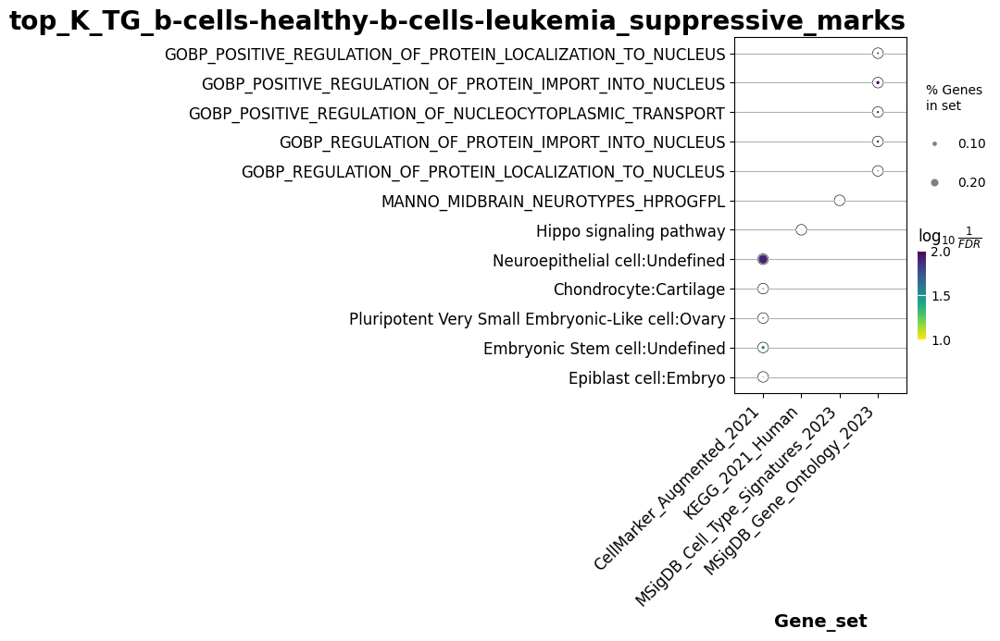

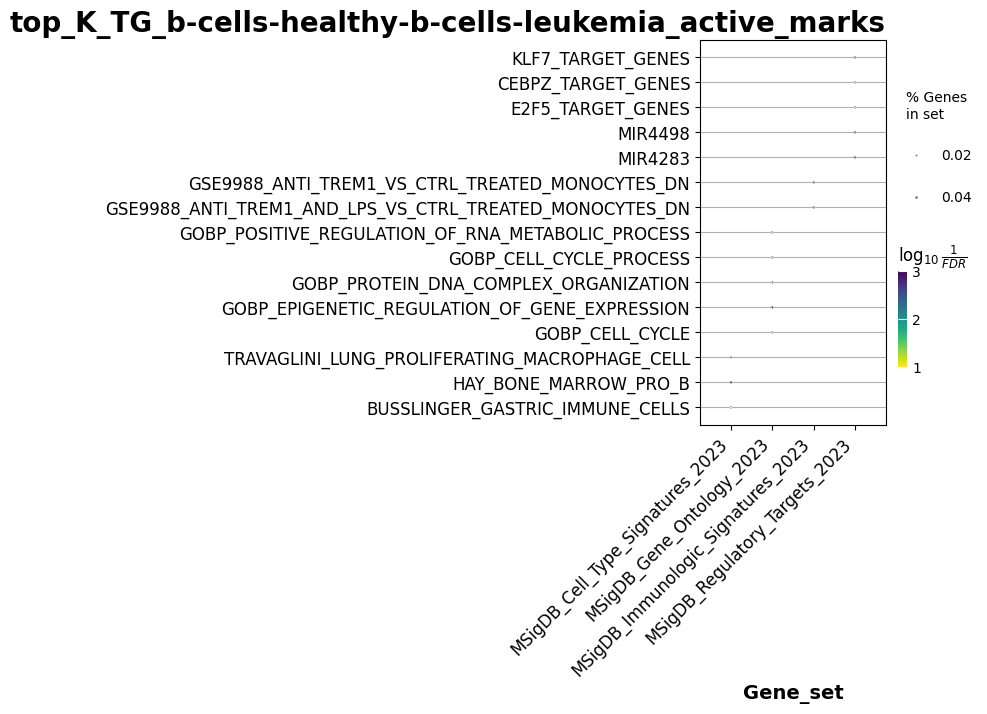

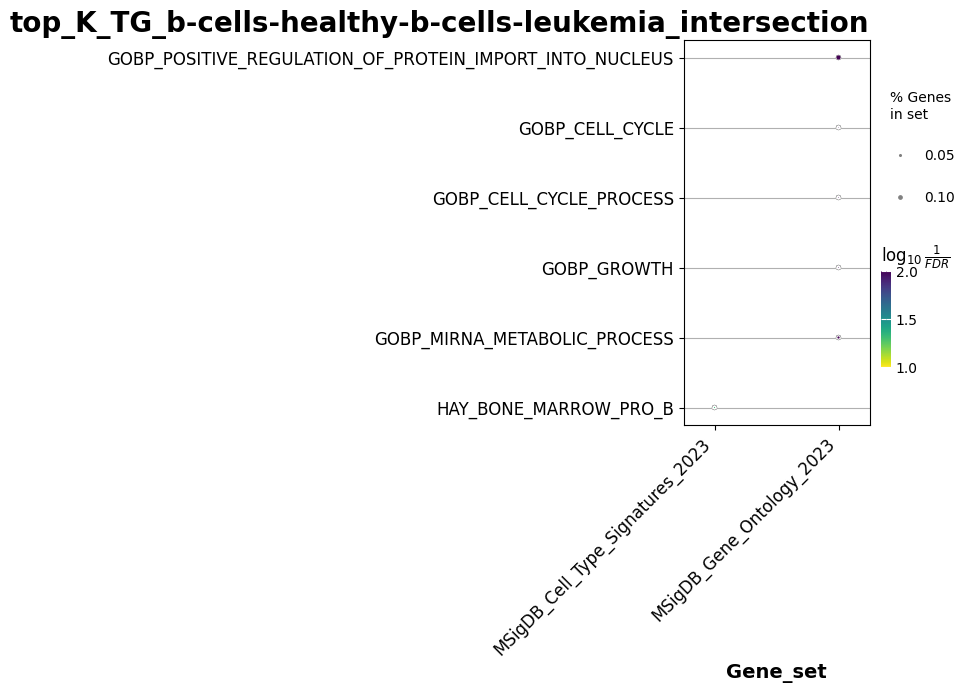

In [58]:
top_k_tg_leukemia_results_dictionary = {}
for index, row in df_leukemia_top_k_tgs_hgnc.iterrows():
    for tf_type in df_leukemia_top_k_tgs_hgnc.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("top_K_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_top_K_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            top_k_tg_leukemia_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

#### with cancer gene sets

For b-cells-healthy-b-cells-leukemia_active_marks
For b-cells-healthy-b-cells-leukemia_intersection


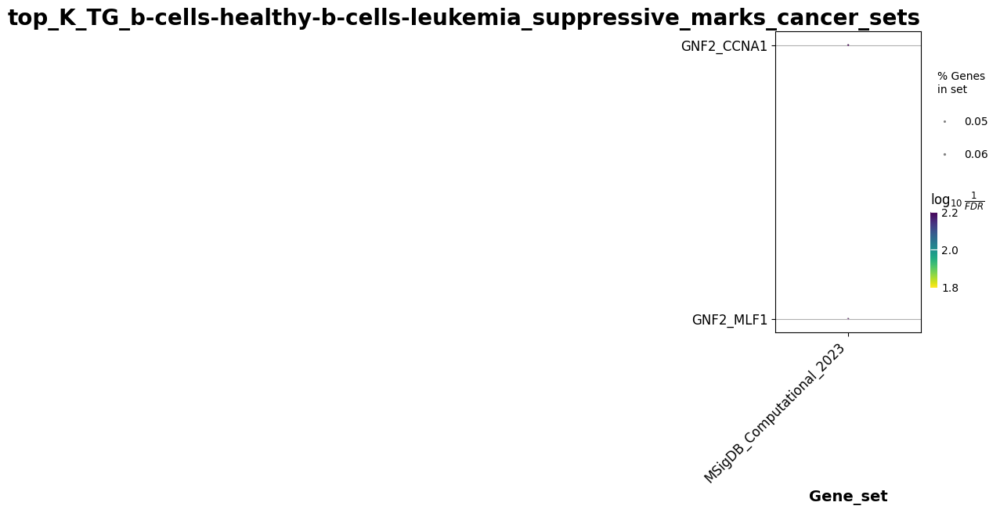

In [57]:
top_k_tg_leukemia_results_dictionary_cancer_sets = {}
for index, row in df_leukemia_top_k_tgs_hgnc.iterrows():
    for tf_type in df_leukemia_top_k_tgs_hgnc.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=cancer_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(cancer_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("top_K_TG_"+index+"_"+tf_type+"_cancer_sets", loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_top_K_TG_"+index+"_"+tf_type+"_cancer_sets"
            #plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            top_k_tg_leukemia_results_dictionary_cancer_sets[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

### all TGs

In [37]:
df_leukemia_all_tgs_hgnc = df_all_tgs_hgnc.loc[["b-cells-healthy-b-cells-leukemia"]]

In [38]:
df_leukemia_all_tgs_hgnc.applymap(lambda x: len(set(x)))

,suppressive_marks,active_marks,intersection
b-cells-healthy-b-cells-leukemia,17834,21118,32990


#### normal gene set

TODO: axis size function and variables adjustments

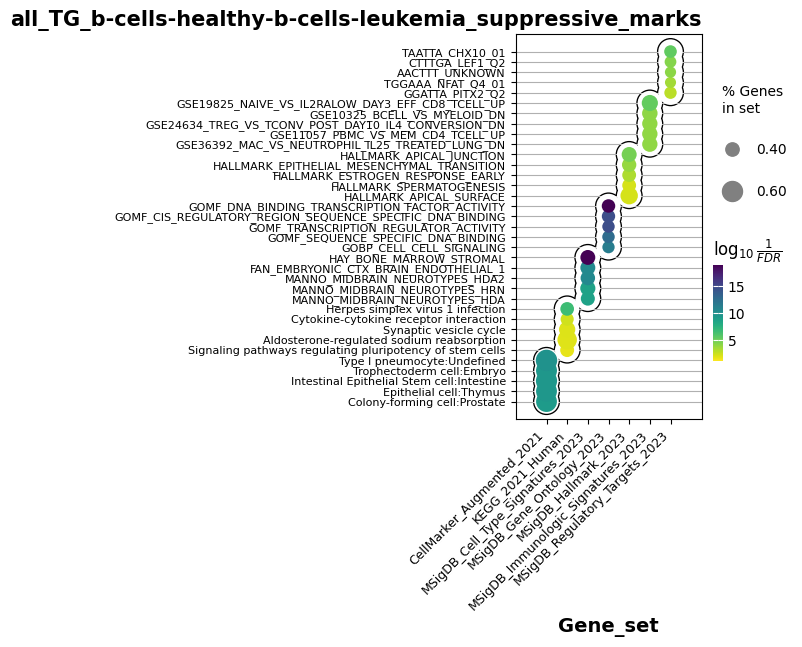

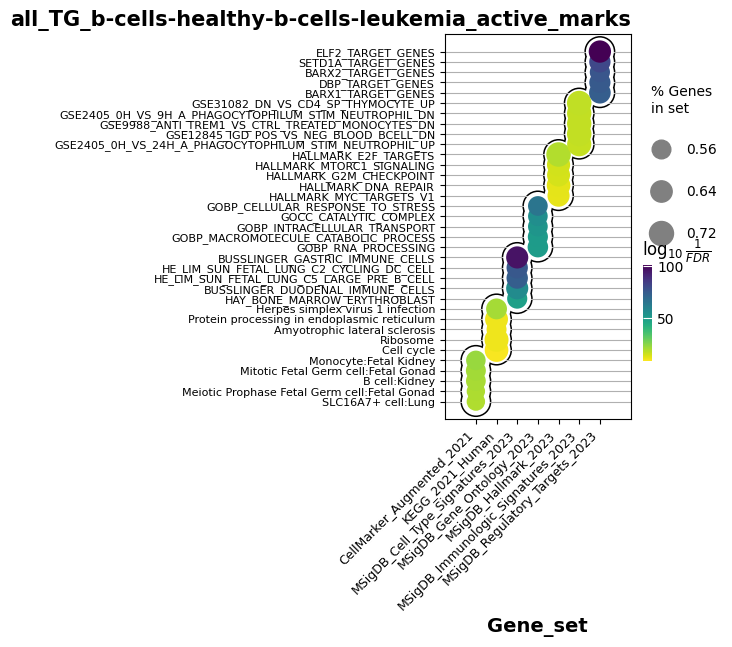

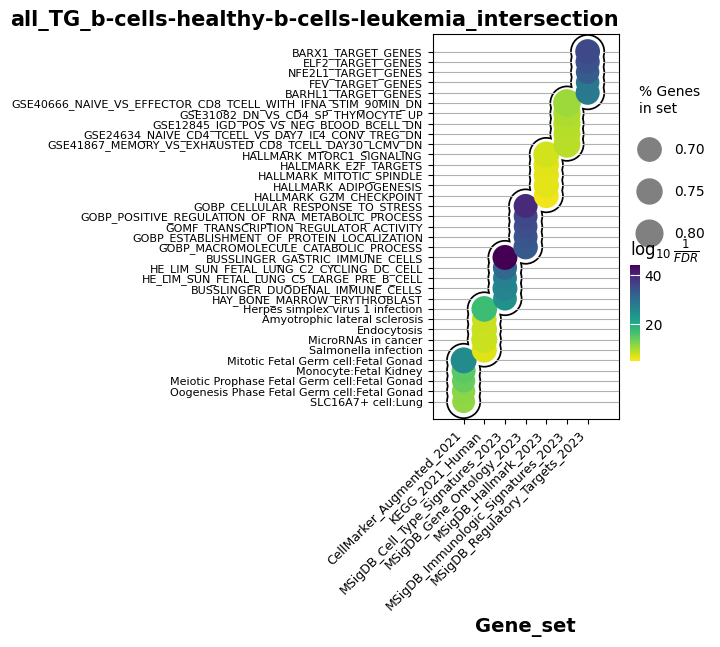

In [56]:
all_tg_leukemia_results_dictionary = {}
for index, row in df_leukemia_all_tgs_hgnc.iterrows():
    for tf_type in df_leukemia_all_tgs_hgnc.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("all_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_all_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            all_tg_leukemia_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

#### cancer gene sets

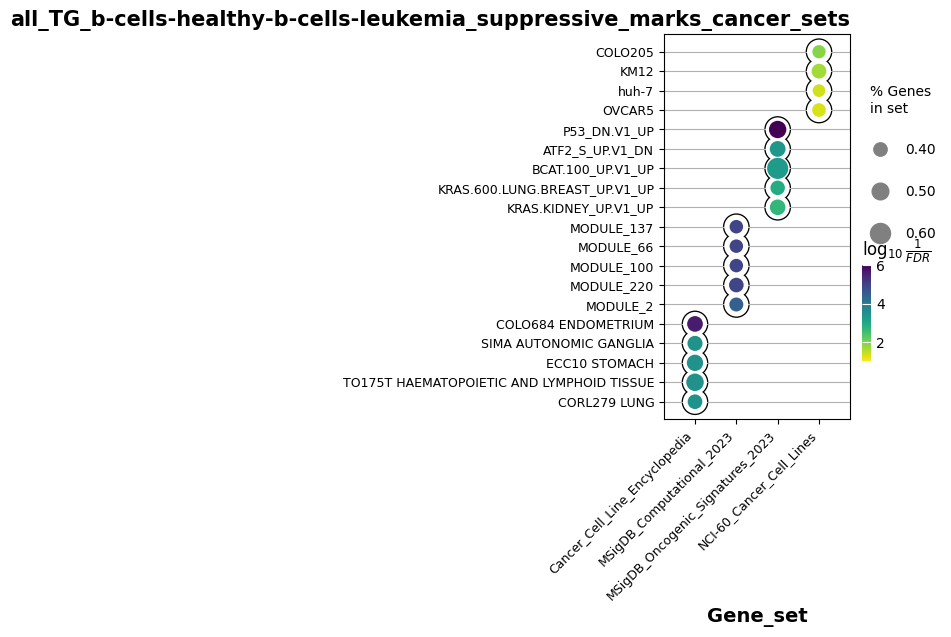

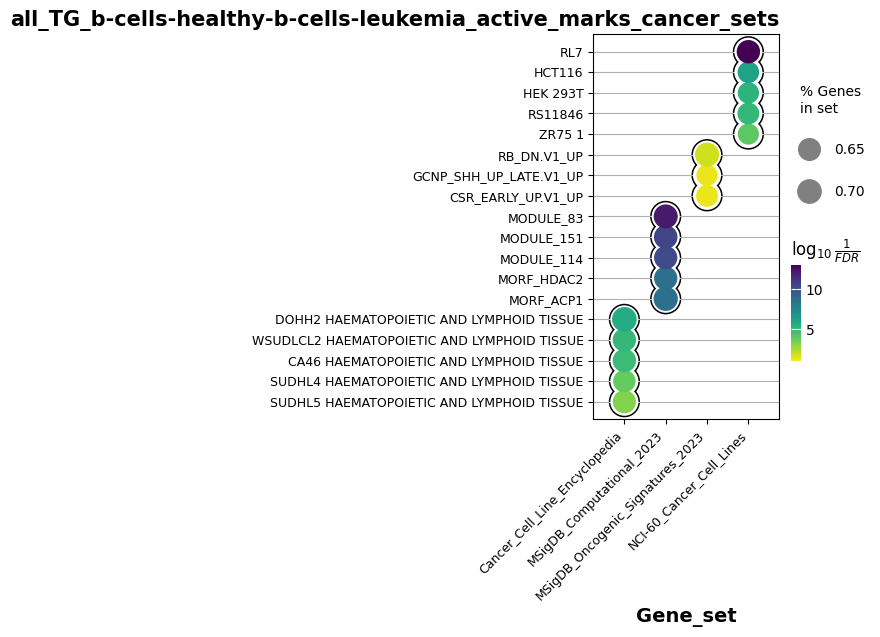

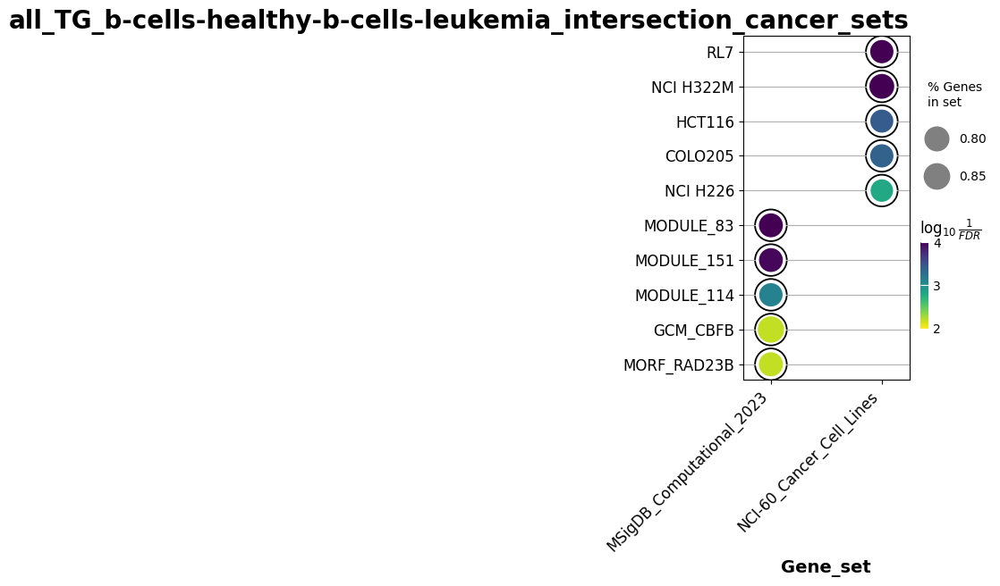

In [59]:
all_tg_leukemia_results_dictionary_cancer_sets = {}
for index, row in df_leukemia_all_tgs_hgnc.iterrows():
    for tf_type in df_leukemia_all_tgs_hgnc.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=cancer_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(cancer_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        x_label=" "
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("all_TG_"+index+"_"+tf_type+"_cancer_sets", loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_all_TG_"+index+"_"+tf_type+"_cancer_sets"
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            all_tg_leukemia_results_dictionary_cancer_sets[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

### Analysis of TF master regulators

In [ ]:
df_leukemia_all_tgs_hgnc

### analysis if what genes are in the TG sets

In [38]:
df_leukemia_all_tgs_hgnc

,suppressive_markers,active_markers,intersection,union,unique,shared_at_least_once,shared_with_all
b-cells-healthy-b-cells-leukemia,"{HNF4A-AS1, AC117947.1, AC087343.1, LARP7P4, A...","{PHAX, REEP5, FSBP, AC008569.1, NOA1, CCNB1IP1...","{HNF4A-AS1, AC087343.1, PHAX, REEP5, FSBP, AC0...","{HNF4A-AS1, AC087343.1, PHAX, REEP5, FSBP, AC0...",{},"{HNF4A-AS1, AC087343.1, PHAX, REEP5, FSBP, AC0...",{}


In [39]:
for col in df_leukemia_all_tgs_hgnc.columns:
    print("ZNF384" in df_leukemia_all_tgs_hgnc[col][0])

True
True
True
True
False
True
False


In [41]:
for col in leukemia_tf_df.columns:
    print("ZNF384" in leukemia_tf_df[col][0])

True
True
True
True
False
True
False


# ORA TF + TG 

creating the merged dataframes for either top K TGs or all TGs

In [8]:
df_tf_top_k_tg_hgnc = pd.DataFrame(index=tf_overlap_df_tpm.index, columns=tf_overlap_df_tpm.columns)
df_tf_all_tgs_hgnc = pd.DataFrame(index=tf_overlap_df_tpm.index, columns=tf_overlap_df_tpm.columns)
for row in tf_overlap_df_tpm.index:
    for col in tf_overlap_df_tpm.columns:
        df_tf_top_k_tg_hgnc.at[row, col] = tf_overlap_df_tpm.at[row, col].union(df_top_k_tg_hgnc.at[row, col])
        df_tf_all_tgs_hgnc.at[row, col] = tf_overlap_df_tpm.at[row, col].union(df_all_tgs_hgnc.at[row, col])

Displaying the sizes of the merged dataframes

In [44]:
df_tf_top_k_tg_hgnc.applymap(lambda x: len(set(x)))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,221,307,232
macrophage-healthy-monocyte-healthy,240,205,247
b-cells-healthy-t-cell-healthy,116,547,91
macrophage-healthy-t-cell-healthy,195,423,65
b-cells-healthy-monocyte-healthy,146,405,232
monocyte-healthy-neutrophil-healthy,182,573,92
t-cell-healthy-neutrophil-healthy,292,636,725
b-cells-healthy-macrophage-healthy,321,75,90
b-cells-healthy-b-cells-leukemia,190,592,476
monocyte-healthy-t-cell-healthy,125,643,96


In [45]:
df_tf_all_tgs_hgnc.applymap(lambda x: len(set(x)))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,9790,356,281
macrophage-healthy-monocyte-healthy,11755,931,1032
b-cells-healthy-t-cell-healthy,116,28059,91
macrophage-healthy-t-cell-healthy,394,26116,65
b-cells-healthy-monocyte-healthy,146,1401,312
monocyte-healthy-neutrophil-healthy,11848,1902,92
t-cell-healthy-neutrophil-healthy,19541,27287,38381
b-cells-healthy-macrophage-healthy,17252,75,90
b-cells-healthy-b-cells-leukemia,17850,21152,32995
monocyte-healthy-t-cell-healthy,129,28249,96


## healthy cells

###  top k target genes

In [47]:
healthy_cells_tf_top_k_tg_df = df_tf_top_k_tg_hgnc.drop(["b-cells-healthy-b-cells-leukemia"])

/nfs/home/students/n.roggendorf/.conda/envs/myenv/lib/python3.8/site-packages/gseapy/plot.py:772: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=self.figsize)


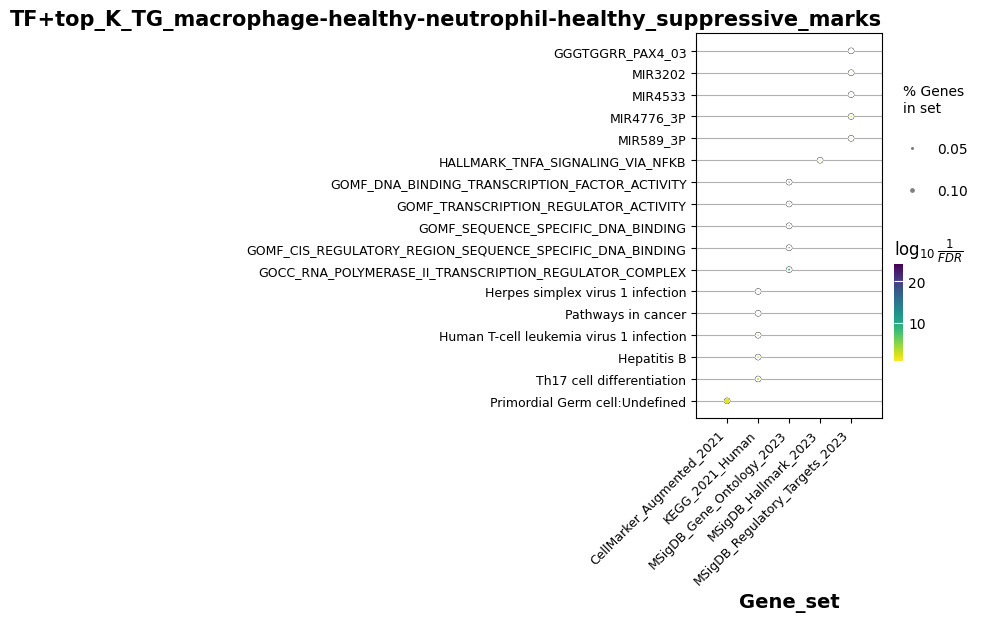

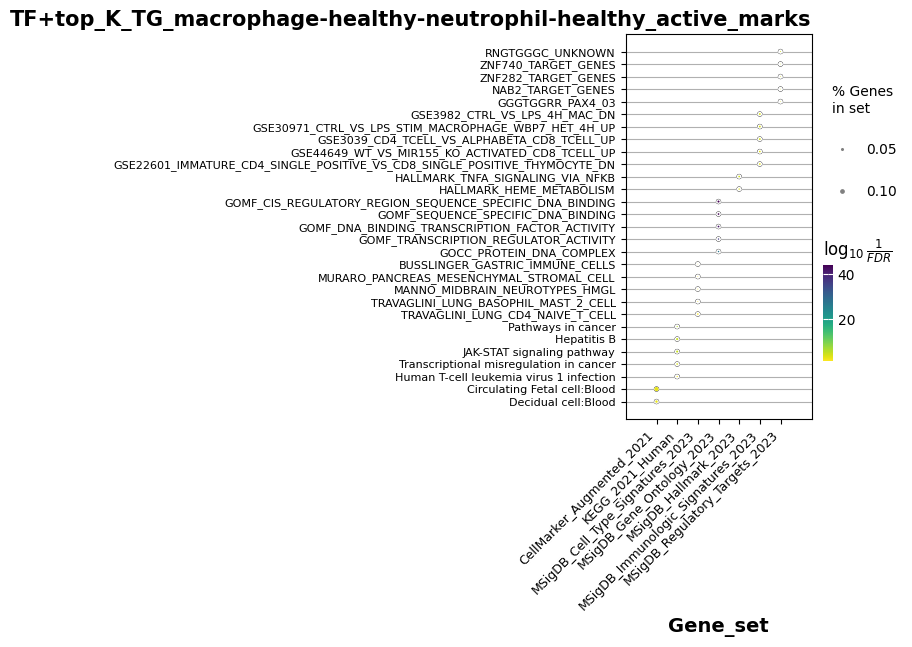

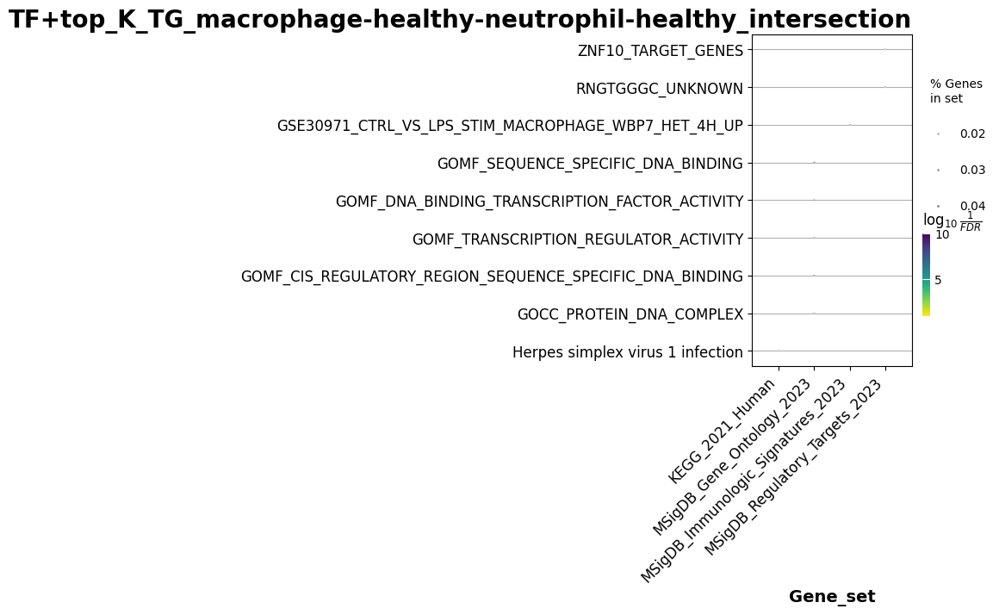

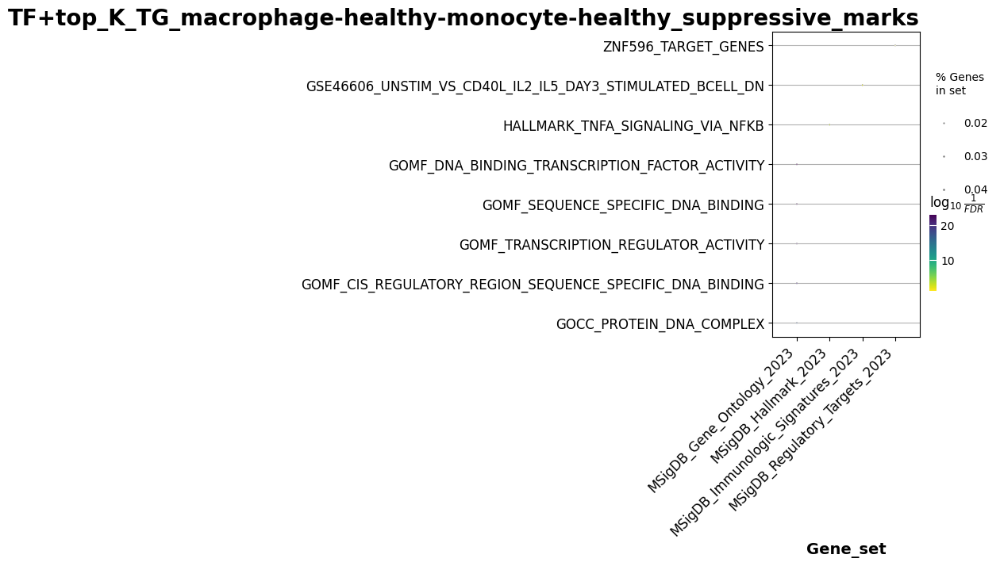

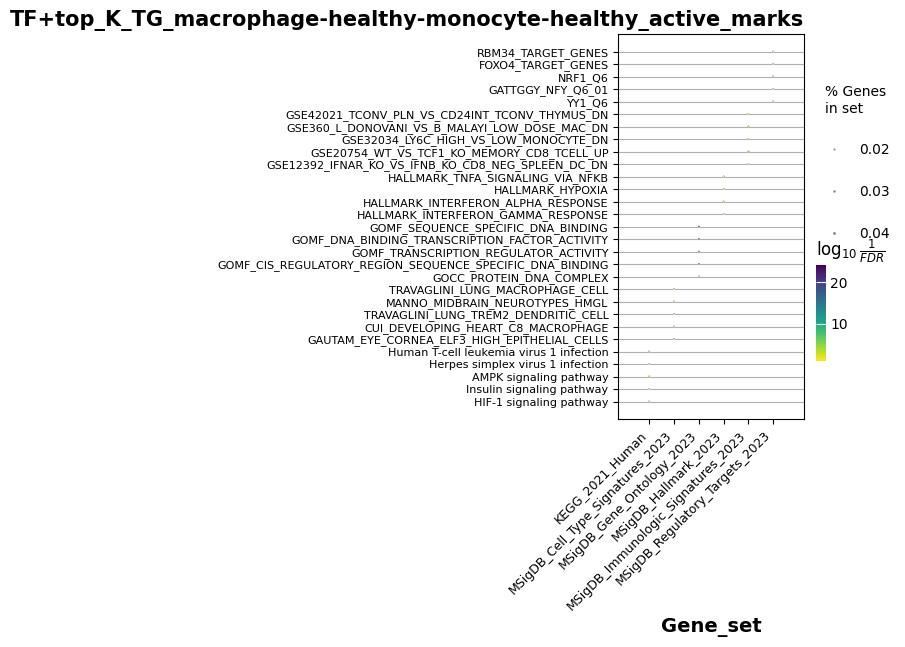

...

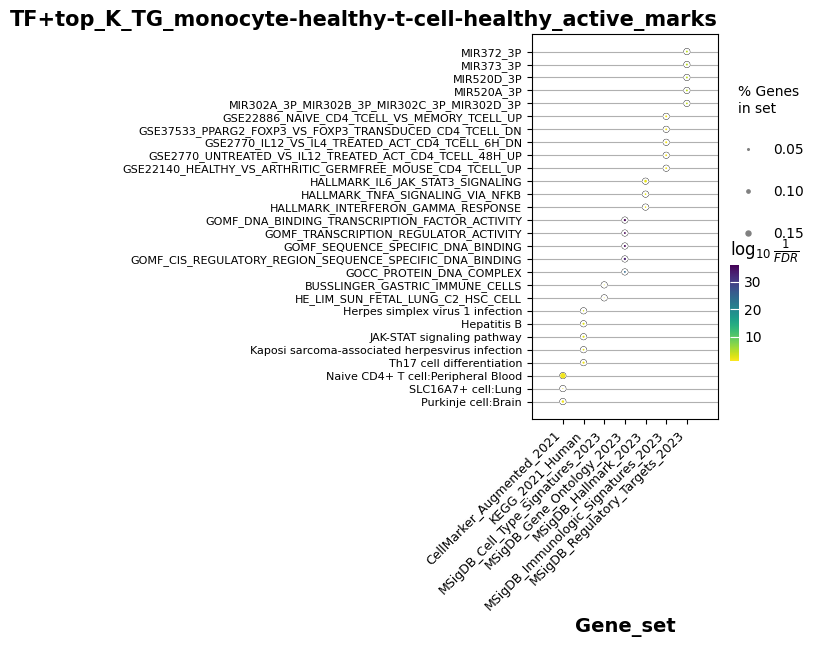

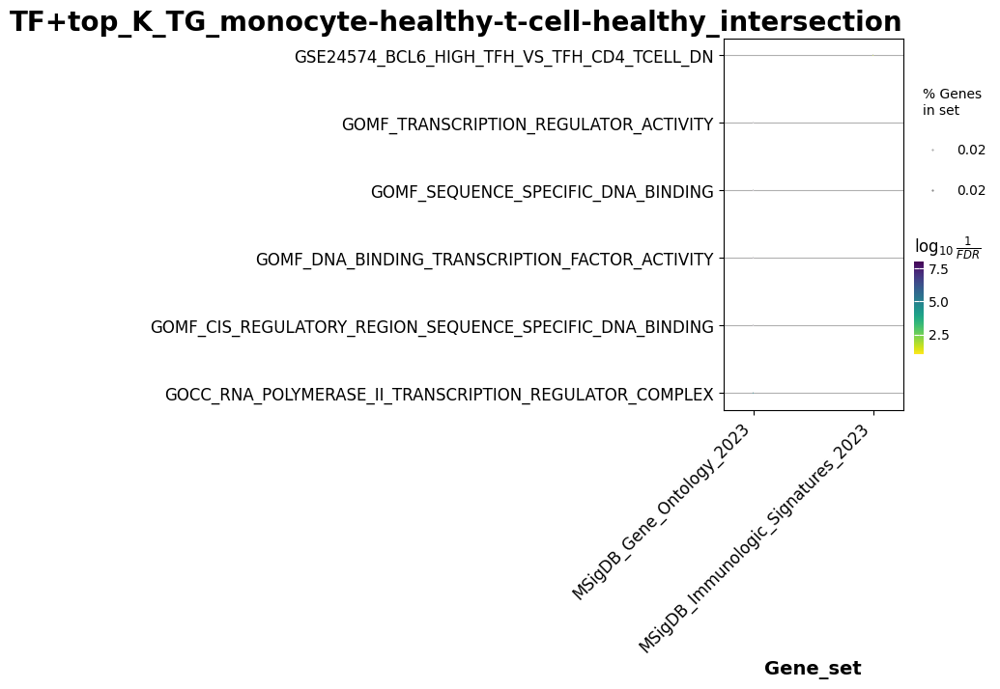

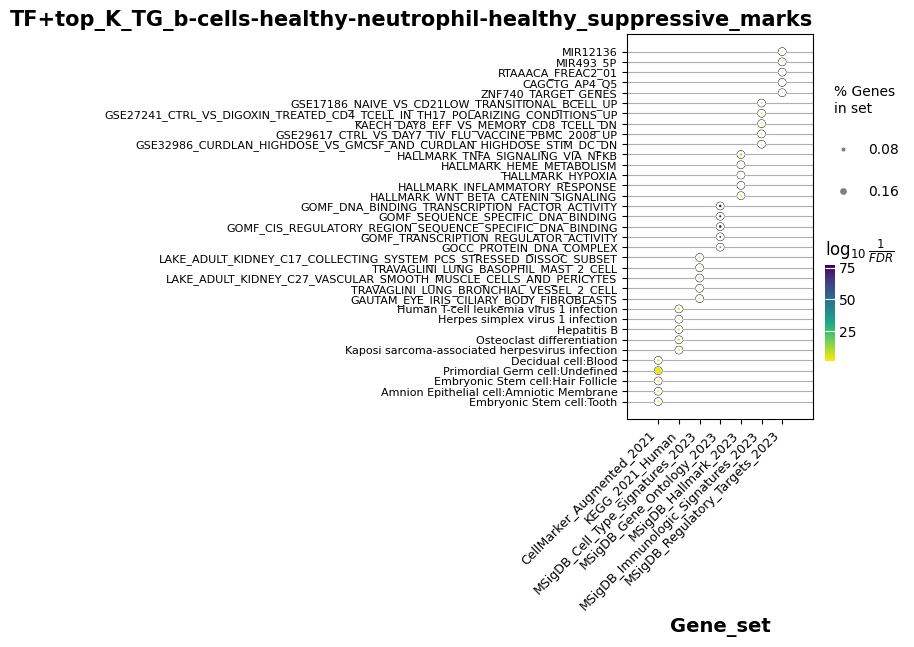

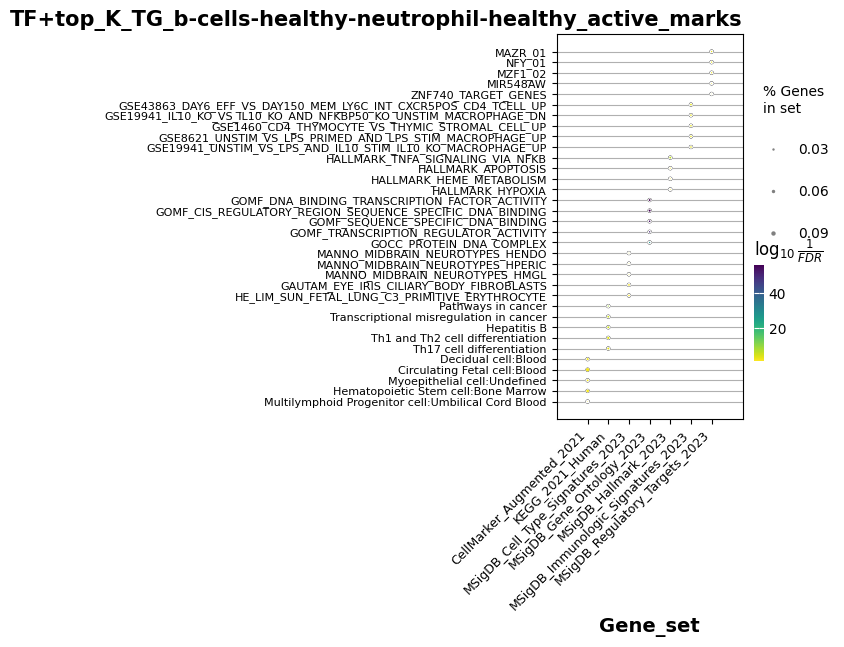

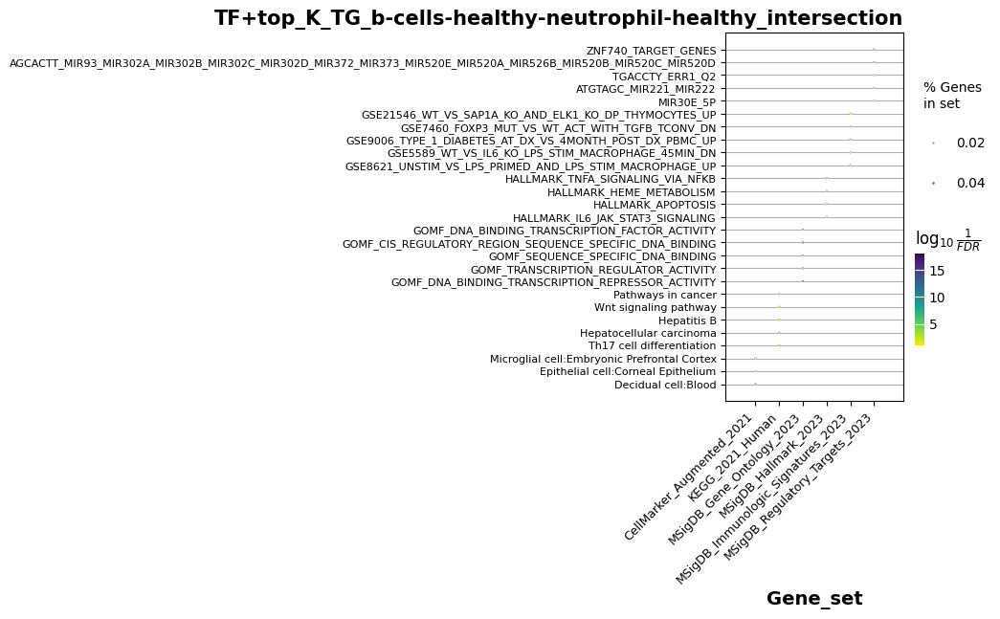

In [48]:
healthy_cells_tf_top_k_tg_results_dictionary = {}
for index, row in healthy_cells_tf_top_k_tg_df.iterrows():
    for tf_type in healthy_cells_tf_top_k_tg_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF+top_K_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_top_K_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            healthy_cells_tf_top_k_tg_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

#### taking a closer look at the enriched sets of the plot, that's  discussed in the thesis (b-cells-healthy-t-cell-healthy_active_marks)

In [15]:
b_cells_t_cells_active = healthy_cells_tf_top_k_tg_results_dictionary["b-cells-healthy-t-cell-healthy_active_marks"]

In [19]:
b_cells_t_cells_active[b_cells_t_cells_active["Gene_set"]=="gs_ind_6"].sort_values(by=["Adjusted P-value"]).head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
13012,gs_ind_6,Human T-cell leukemia virus 1 infection,15/218,5.699606e-08,0.000013,6.613157,110.309326,NFATC2;ELK4;STAT5A;CREB1;NFATC3;ITGAL;ETS1;REL...
13006,gs_ind_6,Hepatitis B,11/159,3.225690e-06,0.000355,6.654864,84.146523,NFATC2;SOS1;STAT5A;CREB1;NFATC3;MYC;STAT2;STAT...
13009,gs_ind_6,Herpes simplex virus 1 infection,19/487,6.414336e-06,0.000470,3.624508,43.338150,ZNF768;STAT2;ZNF454;ZNF317;ZNF549;ZFP82;ZNF415...
13114,gs_ind_6,Th17 cell differentiation,8/106,3.838042e-05,0.001702,7.361578,74.852248,NFATC2;STAT5A;NFATC3;STAT5B;NFKBIB;SMAD4;STAT3...
12943,gs_ind_6,B cell receptor signaling pathway,7/78,3.869162e-05,0.001702,8.929965,90.727437,NFATC2;CD79A;SOS1;NFATC3;NFKBIB;PIK3AP1;JUN
13058,gs_ind_6,PD-L1 expression and PD-1 checkpoint pathway i...,7/88,8.407597e-05,0.003083,7.831496,73.489111,NFATC2;BATF;NFATC3;NFKBIB;STAT3;JUN;RPS6KB1
13113,gs_ind_6,Th1 and Th2 cell differentiation,7/91,1.040116e-04,0.003269,7.552654,69.265452,NFATC2;STAT5A;NFATC3;STAT5B;NFKBIB;RUNX3;JUN
12926,gs_ind_6,Acute myeloid leukemia,6/67,1.410169e-04,0.003878,8.973915,79.568396,SOS1;STAT5A;MYC;STAT5B;STAT3;RPS6KB1
13065,gs_ind_6,Pathways in cancer,17/527,2.004170e-04,0.004749,2.962174,25.223239,SOS1;NCOA3;STAT5A;IL3RA;MYC;CDC42;STAT2;ETS1;A...
13034,gs_ind_6,MAPK signaling pathway,12/294,2.158509e-04,0.004749,3.795920,32.041065,SOS1;CDC42;JUN;NFATC3;MYC;RELB;CACNG7;MEF2C;NR...


-> "T cell receptor signaling pathway" is also a enriched gene set, that has a small enough adjusted p-value

In [21]:
healthy_cells_tf_top_k_tg_df.applymap(lambda x: len(x))

,suppressive_marks,active_marks,intersection
macrophage-healthy-neutrophil-healthy,358,382,232
macrophage-healthy-monocyte-healthy,396,281,247
b-cells-healthy-t-cell-healthy,149,583,91
macrophage-healthy-t-cell-healthy,218,438,65
b-cells-healthy-monocyte-healthy,306,455,232
monocyte-healthy-neutrophil-healthy,228,598,92
t-cell-healthy-neutrophil-healthy,757,862,725
b-cells-healthy-macrophage-healthy,350,114,90
monocyte-healthy-t-cell-healthy,146,687,96
b-cells-healthy-neutrophil-healthy,454,266,188


### all target genes

In [49]:
healthy_cells_tf_all_tg_df = df_tf_all_tgs_hgnc.drop(["b-cells-healthy-b-cells-leukemia"])

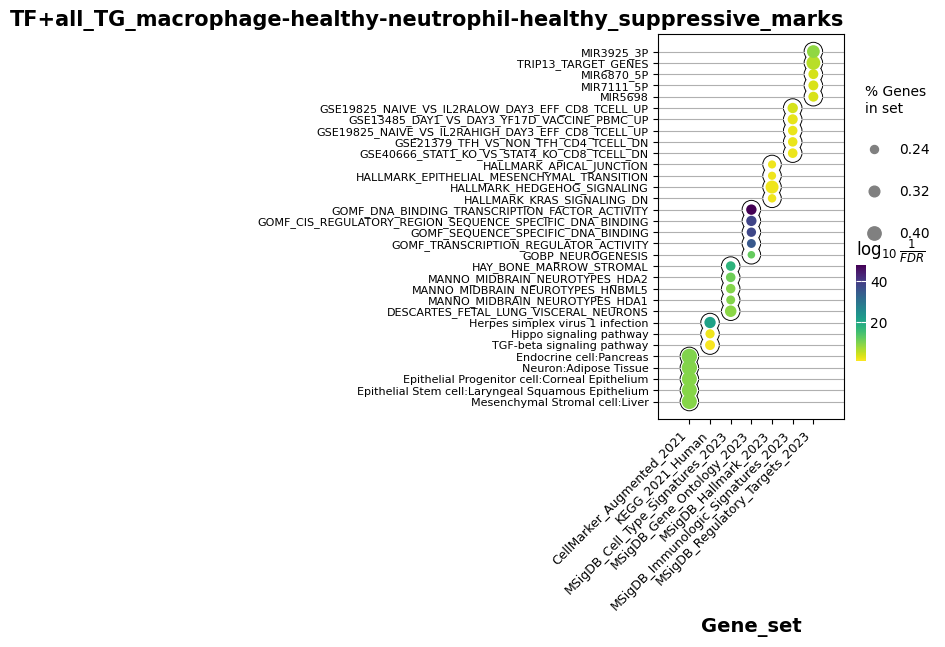

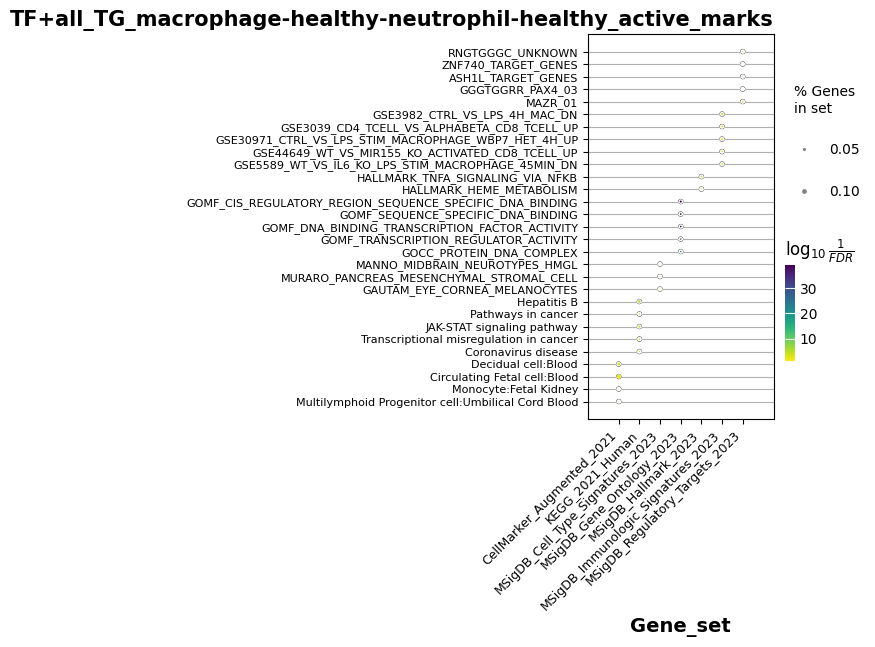

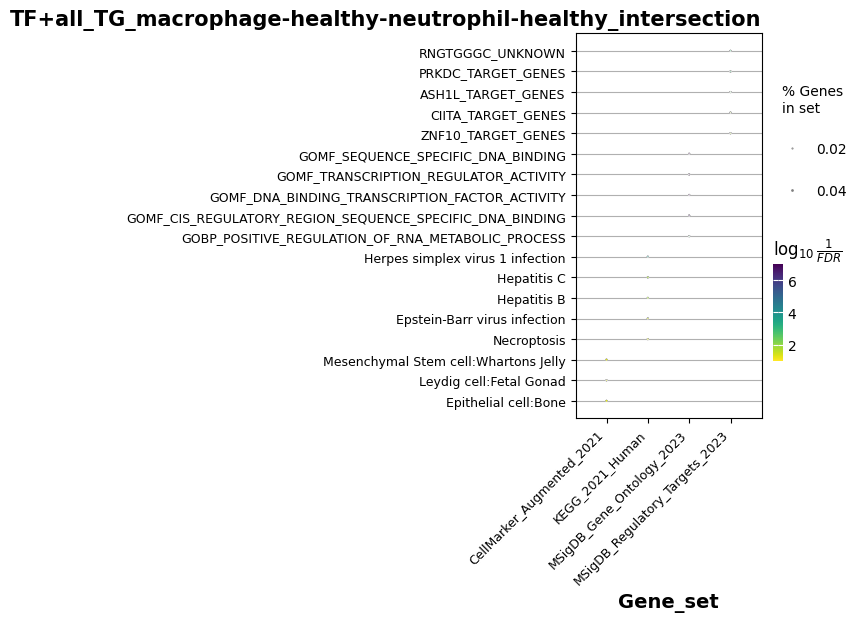

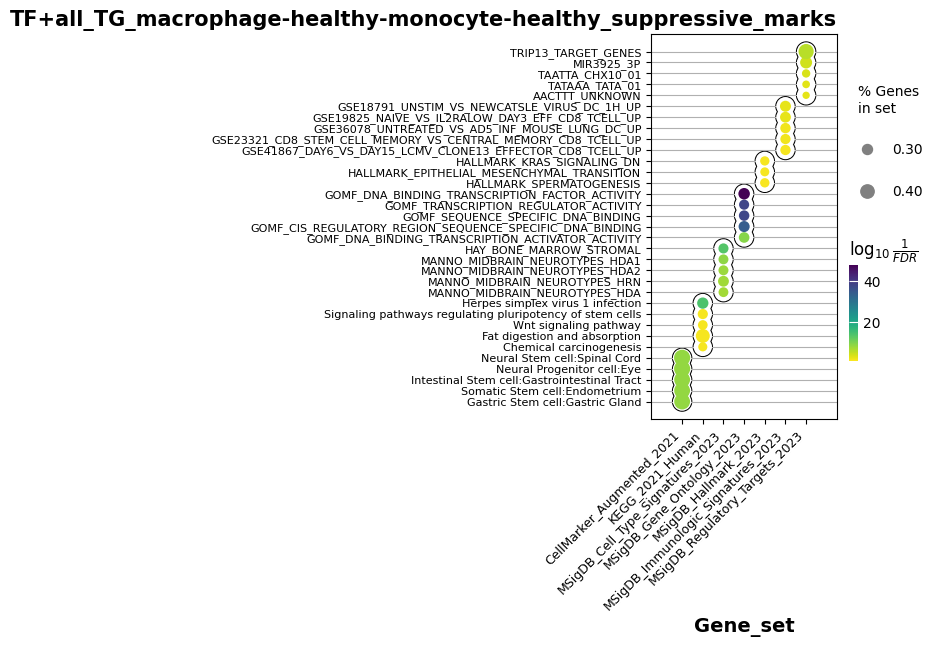

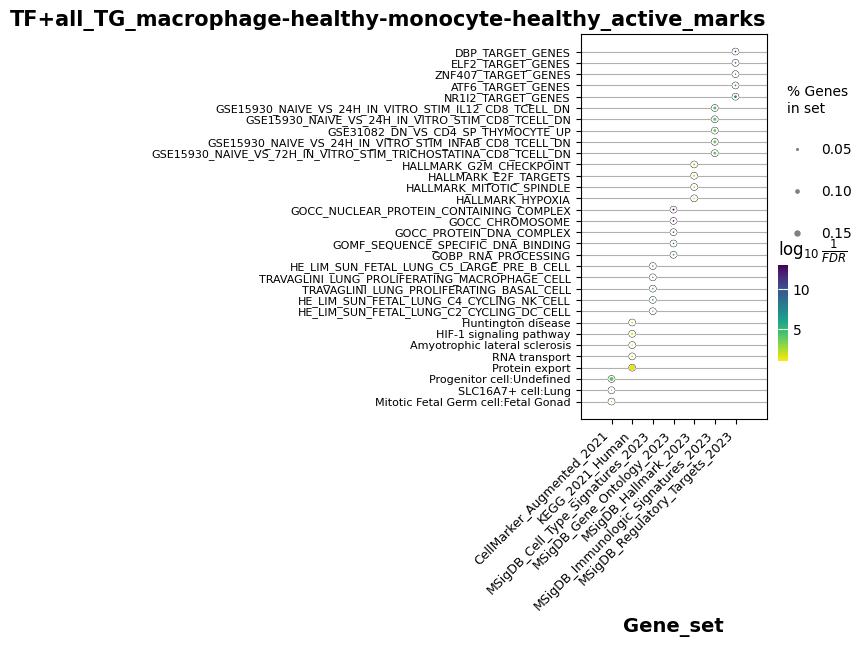

...

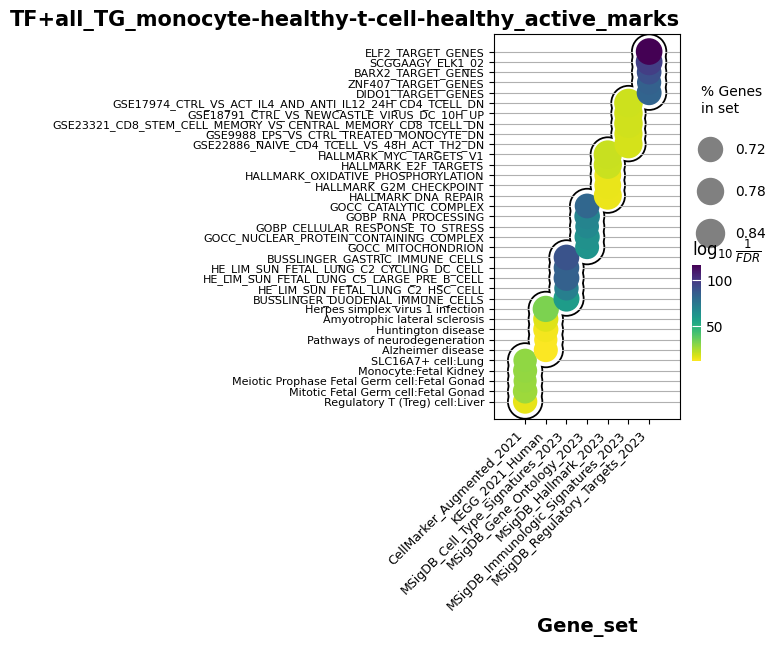

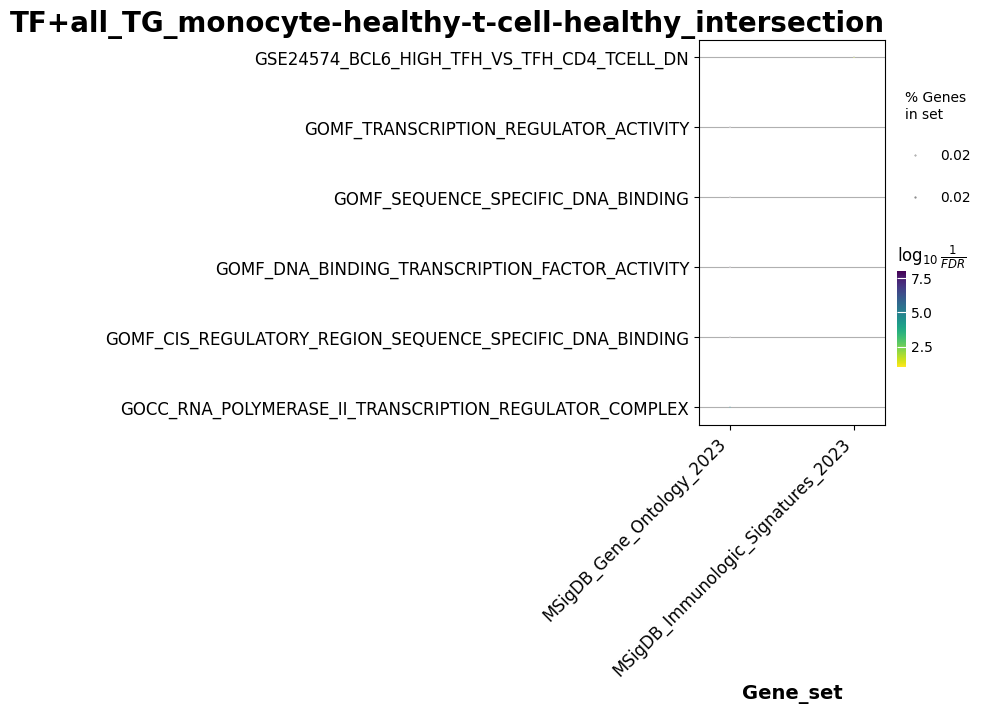

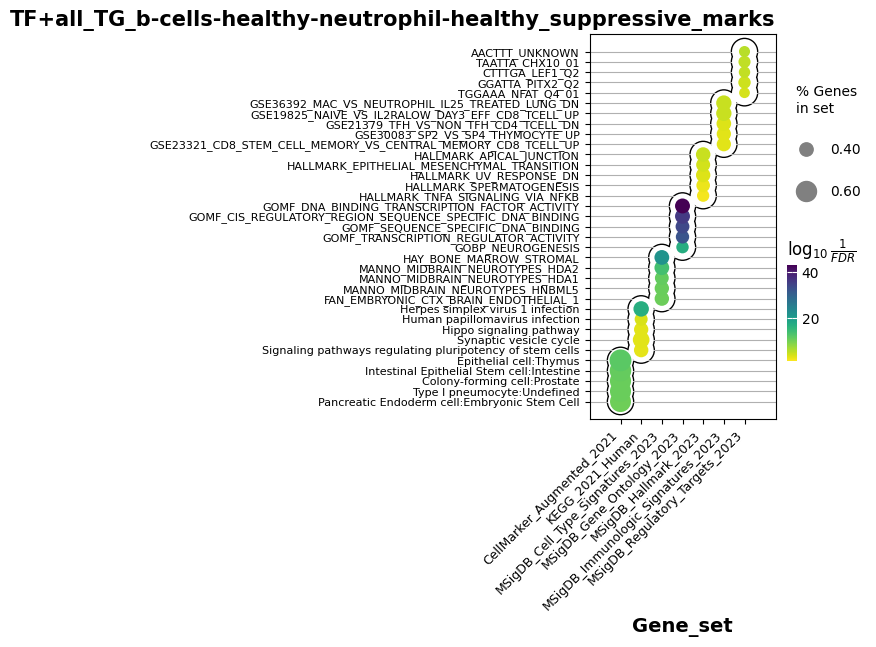

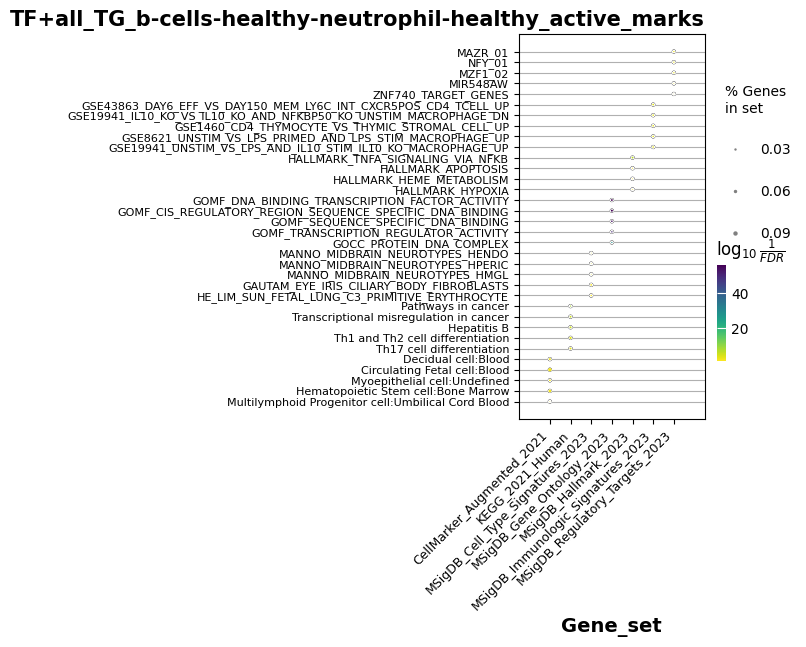

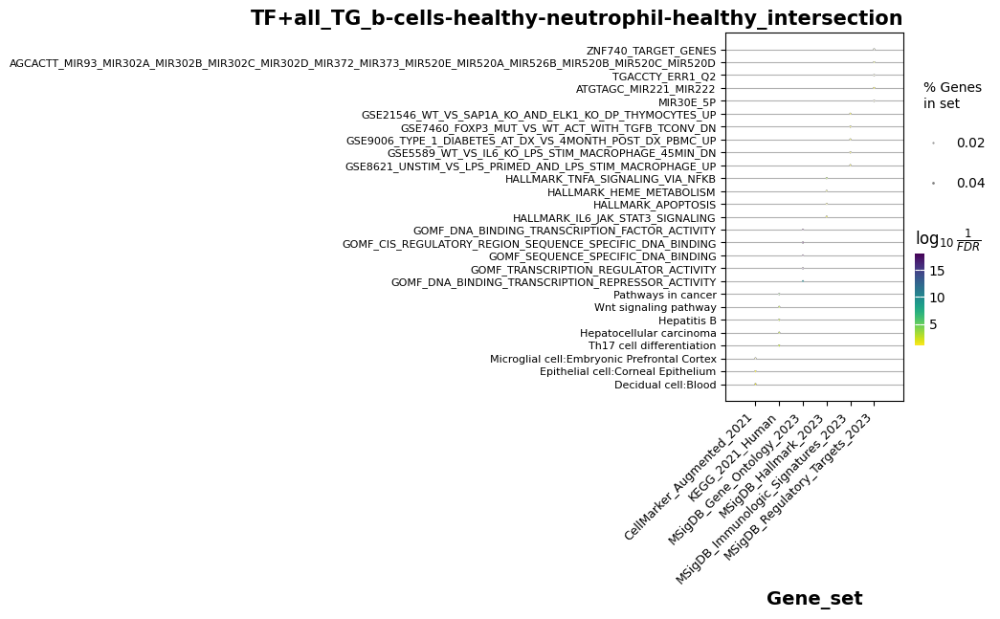

In [50]:
healthy_cells_tf_all_tg_results_dictionary = {}
for index, row in healthy_cells_tf_all_tg_df.iterrows():
    for tf_type in healthy_cells_tf_all_tg_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF+all_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_all_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            healthy_cells_tf_all_tg_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

## leukemia

### top K TGs

In [10]:
leukemia_tf_top_k_tg_df = df_tf_top_k_tg_hgnc.loc[["b-cells-healthy-b-cells-leukemia"]]

#### Normal gene sets

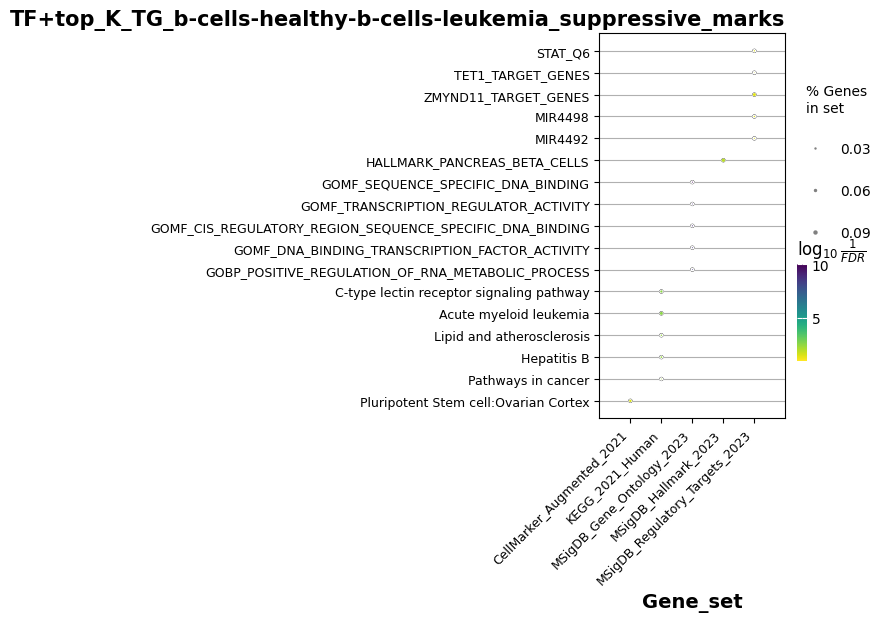

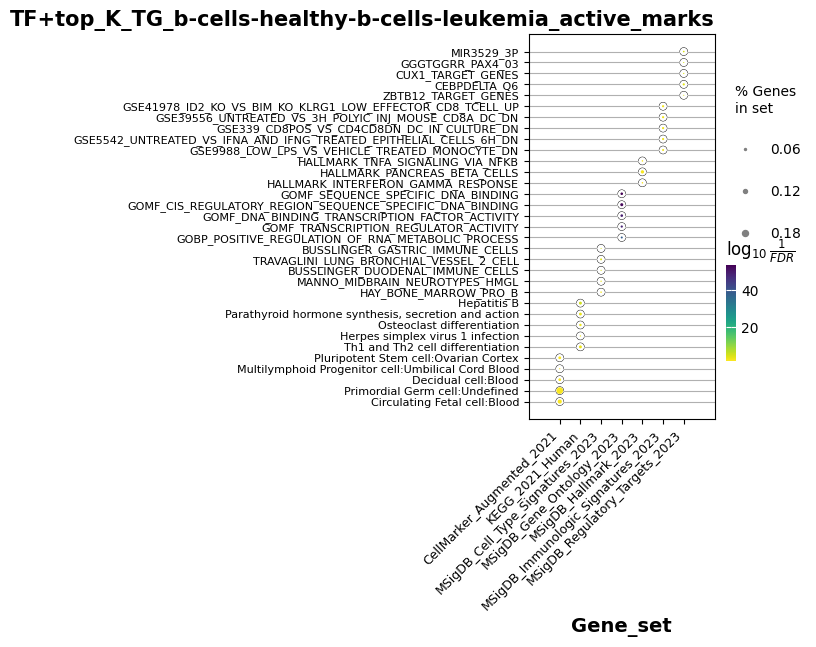

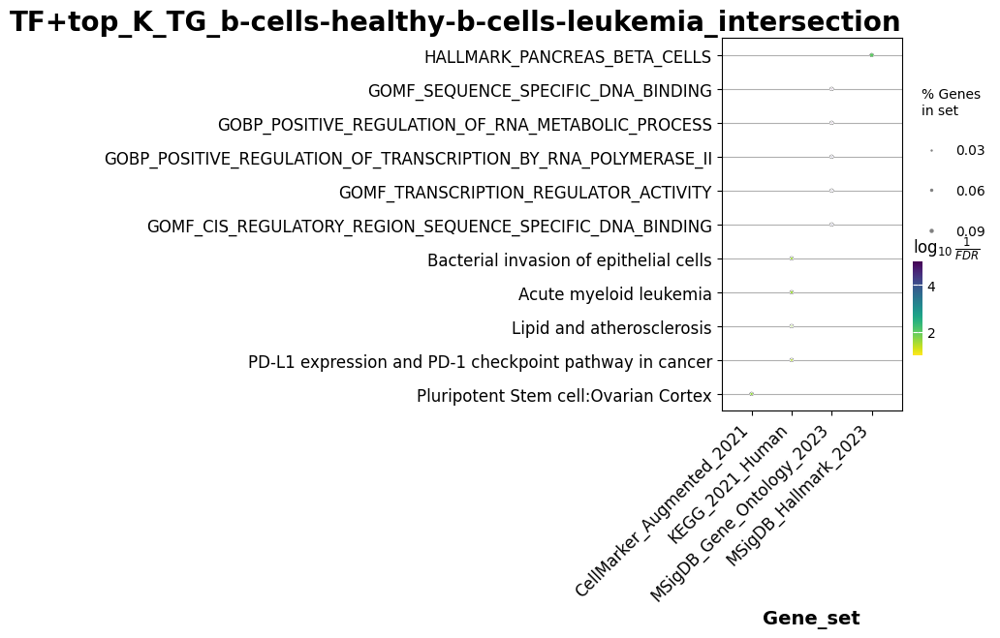

In [14]:
leukemia_tf_top_k_tg_results_dictionary = {}
for index, row in leukemia_tf_top_k_tg_df.iterrows():
    for tf_type in leukemia_tf_top_k_tg_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF+top_K_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_top_K_TG_"+index+"_"+tf_type+"_new"
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            leukemia_tf_top_k_tg_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

##### analyszing what genes are in the acute myeloid leukemia sets and if some of them have a known association with e.g. ALL

In [71]:
leukemia_suppressive_results_df = leukemia_tf_top_k_tg_results_dictionary["b-cells-healthy-b-cells-leukemia_suppressive_marks"]

In [73]:
leukemia_suppressive_results_df[leukemia_suppressive_results_df["Term"]=="Acute myeloid leukemia"]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
11270,KEGG_2021_Human,Acute myeloid leukemia,6/67,0.000019,0.002673,12.974433,140.748837,CEBPA;PIK3R1;STAT3;RPS6KB1;MYC;SOS1


In [69]:
leukemia_suppressive_results_df[leukemia_suppressive_results_df["Term"]=="Acute myeloid leukemia"]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
7314,KEGG_2021_Human,Acute myeloid leukemia,2/67,0.019217,0.117438,12.179837,48.134139,MYC;CEBPA


In [72]:
leukemia_suppressive_results_df[leukemia_suppressive_results_df["Term"]=="Acute myeloid leukemia"]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
7314,KEGG_2021_Human,Acute myeloid leukemia,2/67,0.019217,0.117438,12.179837,48.134139,MYC;CEBPA


In [76]:
leukemia_suppressive_results_df[leukemia_suppressive_results_df["Term"]=="Pathways in cancer"]["Genes"].to_list()

['STAT2;MAX;GLI3;CDH1;CEBPA;PIK3R1;STAT3;RPS6KB1;NFE2L2;CALM2;MYC;SOS1;CDC42;TXNRD2']

#### cancer gene sets

For b-cells-healthy-b-cells-leukemia_intersection


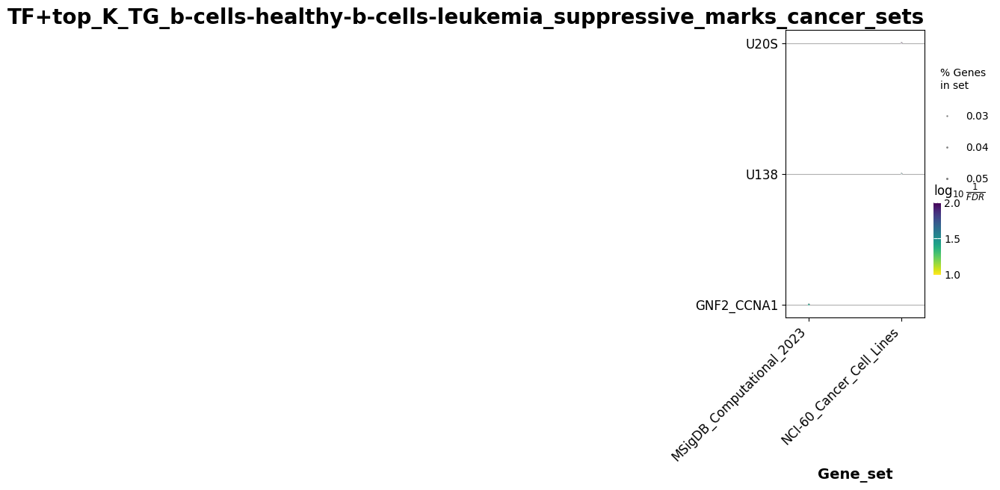

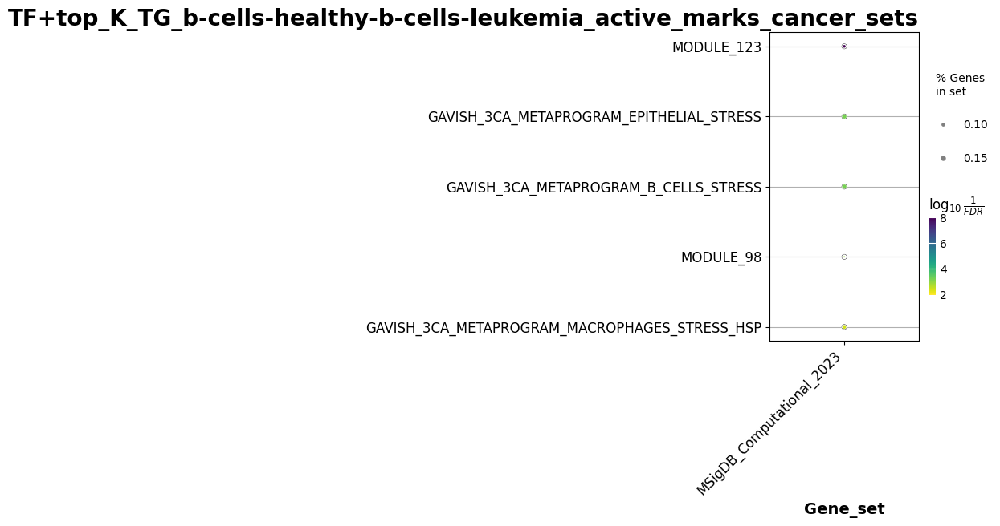

In [61]:
leukemia_tf_top_k_tg_results_dictionary_cancer_sets = {}
for index, row in leukemia_tf_top_k_tg_df.iterrows():
    for tf_type in leukemia_tf_top_k_tg_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=cancer_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        try:
            enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(cancer_gene_sets_renaming)
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF+top_K_TG_"+index+"_"+tf_type+"_cancer_sets", loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_top_K_TG_"+index+"_"+tf_type+"_cancer_sets"
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            leukemia_tf_top_k_tg_results_dictionary_cancer_sets[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

In [33]:
for collection in normal_gene_sets:
    for gene_set in collection.keys():
        if "leukemia" in gene_set:
            print(gene_set)
            print(collection[gene_set])

Acute myeloid leukemia
['DUSP6', 'BAD', 'JUP', 'ZBTB16', 'RUNX1', 'BRAF', 'IL3', 'PML', 'PIK3CB', 'PIK3CA', 'RARA', 'SOS2', 'RAF1', 'SOS1', 'LEF1', 'RELA', 'CSF2', 'BCL2A1', 'MPO', 'PIK3R3', 'ARAF', 'PIK3R2', 'NRAS', 'CCND1', 'AKT3', 'MYC', 'AKT1', 'AKT2', 'RUNX1T1', 'STAT5B', 'MAP2K2', 'TCF7L2', 'TCF7L1', 'CHUK', 'MAP2K1', 'STAT3', 'MTOR', 'NFKB1', 'CCNA2', 'PER2', 'CCNA1', 'KIT', 'PIK3R1', 'RPS6KB2', 'RPS6KB1', 'TCF7', 'GRB2', 'KRAS', 'PPARD', 'CEBPA', 'CSF1R', 'SPI1', 'CEBPE', 'FLT3', 'EIF4EBP1', 'PIK3CD', 'ITGAM', 'IKBKB', 'FCGR1A', 'MAPK3', 'PIM2', 'PIM1', 'HRAS', 'MAPK1', 'CD14', 'IKBKG', 'STAT5A']
Chronic myeloid leukemia
['TGFB1', 'TGFB3', 'TGFB2', 'BAD', 'GAB2', 'RUNX1', 'PTPN11', 'BRAF', 'TGFBR1', 'TGFBR2', 'NFKBIA', 'CDK6', 'PIK3CB', 'PIK3CA', 'CDK4', 'BAX', 'SOS2', 'TP53', 'RAF1', 'SOS1', 'RB1', 'RELA', 'SHC3', 'SHC4', 'SHC1', 'SHC2', 'PIK3R3', 'ARAF', 'PIK3R2', 'CRKL', 'NRAS', 'CCND1', 'MECOM', 'AKT3', 'E2F1', 'MYC', 'AKT1', 'E2F2', 'AKT2', 'E2F3', 'SMAD3', 'STAT5B', 'MAP2

In [39]:
for collection in cancer_gene_sets:
    for gene_set in collection.keys():
        if "MLL" in gene_set:
            #print(str(collection))
            print(gene_set)
            print(collection[gene_set])
        elif "CLL" in gene_set:
            #print(str(collection))
            print(gene_set)
            print(collection[gene_set])

GCM_MLL
['AAAS', 'AARS2', 'ABHD16A', 'ACTR10', 'ANKRA2', 'ANKRD10', 'ANKRD12', 'APBB3', 'ASB3', 'ASCC1', 'ATG2B', 'ATG4B', 'ATOSA', 'BAHD1', 'BAZ2A', 'BOD1L1', 'BPTF', 'BRD9', 'C1orf52', 'C2CD5', 'CASP2', 'CELF1', 'CHAMP1', 'CHD9', 'CHTOP', 'CLEC16A', 'CLK4', 'CNOT6', 'CNPPD1', 'COMMD9', 'COQ10A', 'CRAMP1', 'CREB1', 'CREBRF', 'CS', 'CSRNP2', 'CUL5', 'DDX47', 'DENND4A', 'DFFA', 'DHX36', 'DYNC1I2', 'EPC2', 'EPM2AIP1', 'ERG28', 'EXOC5', 'FAM168B', 'FAN1', 'FBXL20', 'FNTB', 'FOXO3', 'GFM2', 'GPBP1', 'GSPT1', 'HAPSTR1', 'HGS', 'HNRNPH3', 'HNRNPR', 'IDH3G', 'ING4', 'INTS5', 'IPO5', 'IPO9', 'IQCK', 'ISCA1', 'JKAMP', 'KAT6B', 'KDM3B', 'KHDC4', 'KLHL11', 'KMT2A', 'LEMD3', 'LINC01278', 'LUC7L3', 'MAEA', 'MARCHF7', 'MED17', 'MEPCE', 'METTL17', 'MICU1', 'MOB4', 'MORF4L1', 'MSL1', 'MTMR3', 'MTMR4', 'MTMR7', 'MTPN', 'NAA25', 'NCOA5', 'NF2', 'NFYA', 'NSUN5P1', 'NUMA1', 'NUP133', 'NXF1', 'OCIAD1', 'OTUD6B', 'PACS2', 'PAFAH1B2', 'PATL1', 'PCF11', 'PGRMC2', 'PHF2', 'PKNOX1', 'POGZ', 'PPIG', 'PRDM4', 'PR

### all TGs

In [62]:
leukemia_tf_all_tg_df = df_tf_all_tgs_hgnc.loc[["b-cells-healthy-b-cells-leukemia"]]

#### normal gene sets

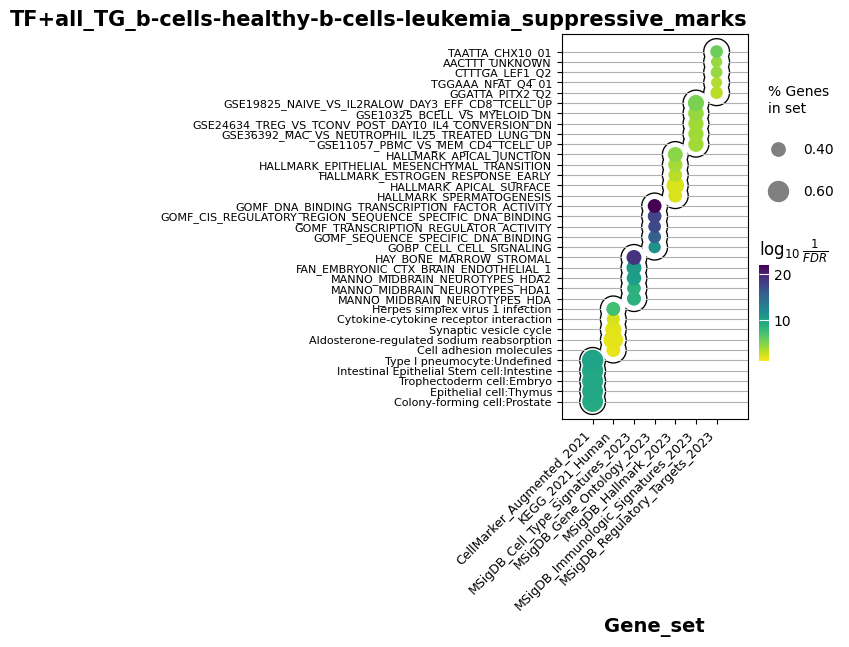

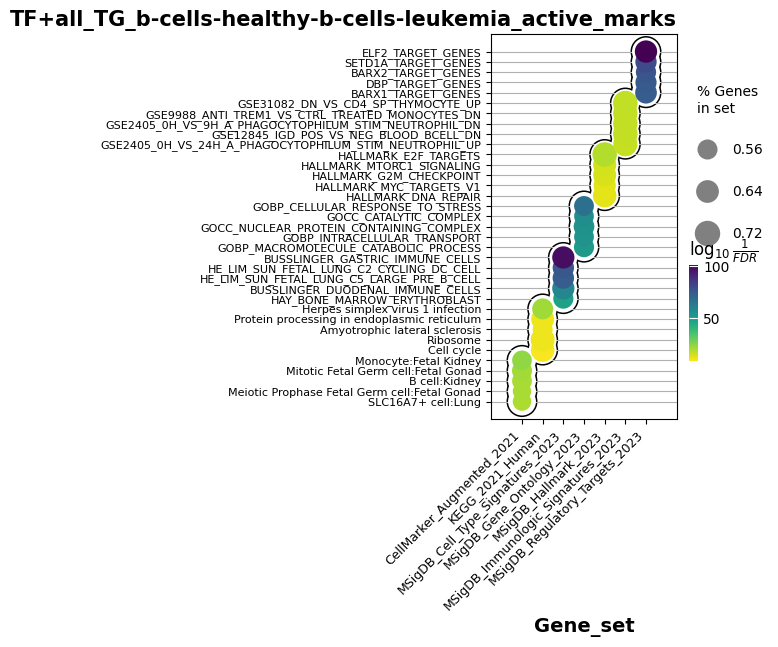

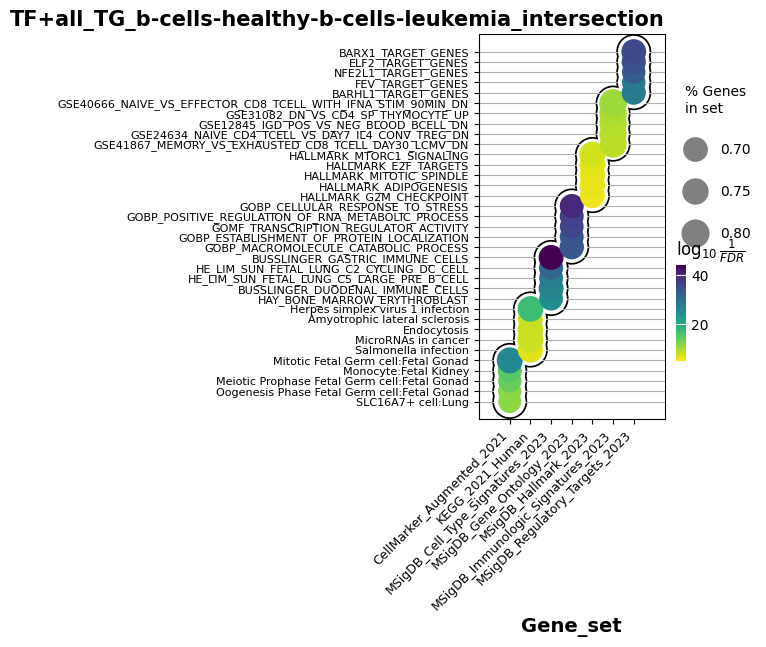

In [63]:
leukemia_tf_all_tg_results_dictionary = {}
for index, row in leukemia_tf_all_tg_df.iterrows():
    for tf_type in leukemia_tf_all_tg_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=normal_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(normal_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF+all_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_all_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            leukemia_tf_all_tg_results_dictionary[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)

#### cancer gene sets

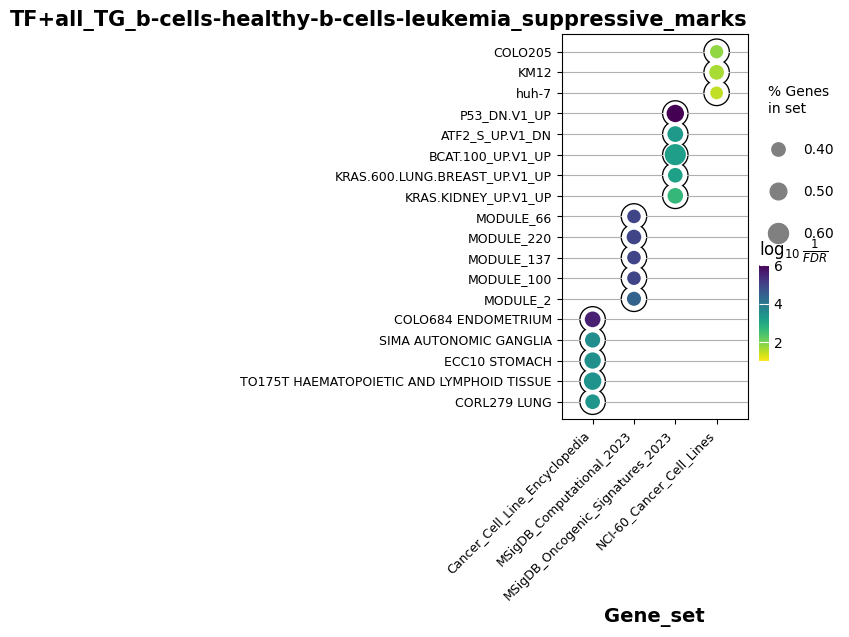

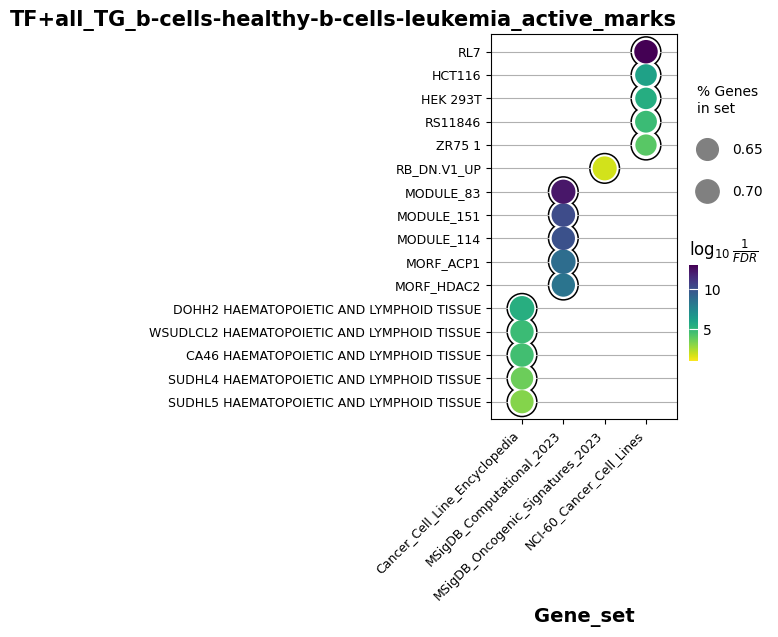

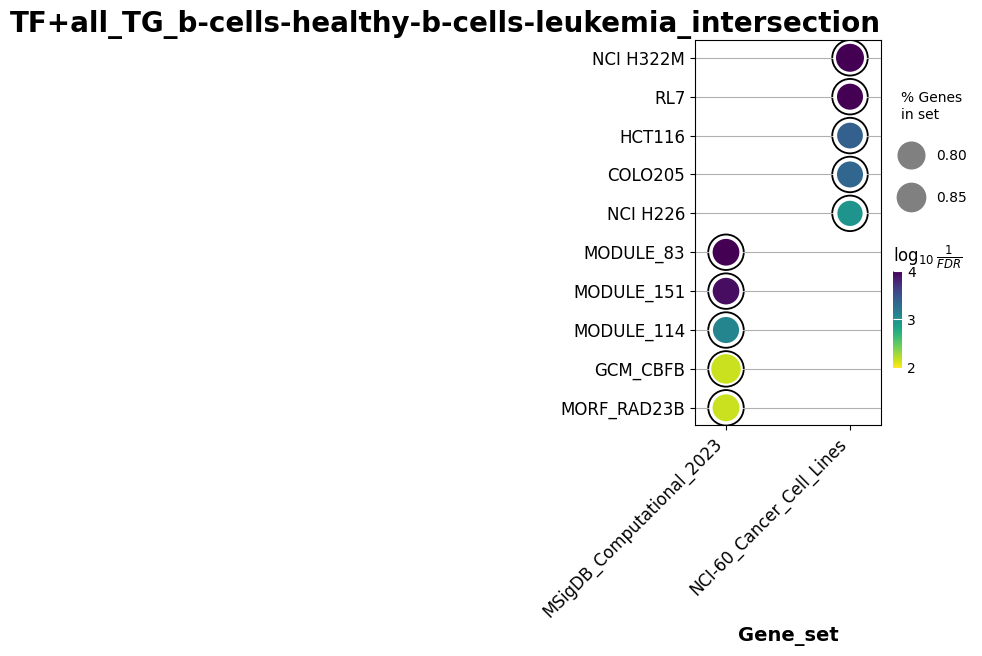

In [64]:
leukemia_tf_all_tg_results_dictionary_cancer_sets = {}
for index, row in leukemia_tf_all_tg_df.iterrows():
    for tf_type in leukemia_tf_all_tg_df.columns:
        genes = list(myfunc.adjust_tfprio_used_TF(row[tf_type]))
        enr_bg = gp.enrichr(gene_list=genes,
                    gene_sets=cancer_gene_sets,
                    organism='human', # organism argment is ignored because user input a background
                    #background=all_tfs_adjusted,
                    outdir=None, # don't write to disk
                    )
        enr_bg.results["Gene_set"] = enr_bg.results["Gene_set"].replace(cancer_gene_sets_renaming)
        try:
            ax = gp.dotplot(enr_bg.results,
                        column="Adjusted P-value",
                        x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
                        size=4,
                        top_term=5,
                        figsize=(3,5),
                        #title = index+"_"+tf_type,
                        xticklabels_rot=45, # rotate xtick labels
                        show_ring=True, # set to False to revmove outer ring
                        marker='o',
                        )
            x_axis_size, y_axis_size, title_size = myfunc.enrichr_adjust_axis_title_font_sizes(enr_bg.results)
            ax.tick_params(axis='y', labelsize=y_axis_size)
            ax.tick_params(axis='x', labelsize=x_axis_size)
            ax.set_title("TF+all_TG_"+index+"_"+tf_type, loc="right", fontsize=title_size,fontweight='bold')
            figure_file_name = "ORA_TF_all_TG_"+index+"_"+tf_type
            plt.savefig(os.path.join(path_to_figure_folder, figure_file_name), bbox_inches='tight')
            leukemia_tf_all_tg_results_dictionary_cancer_sets[index+"_"+tf_type] = enr_bg.results
        except ValueError as ve:
            print("For "+str(index)+"_"+tf_type)
            print(ve)